In [1]:
import os
import tempfile

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import rcParams
from matplotlib import cm, colors
import scanpy as sc
import pandas as pd
import seaborn as sb
import scipy as sp
import numpy as np
import torch
from rich import print


# Define the path to the directory you want to change to
new_directory = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined'

# Use os.chdir() to change the working directory
os.chdir(new_directory)

In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12) #color_map=mymap2)
sc.settings.figdir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined/figures/'
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


# TEST NEW MOVED FILE FOR DATA

In [4]:
adata_all = sc.read('/scratch365/eaboelno/SAVE_from_afs/sysVI_h2m_NEW_allgenes.h5ad')
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [ ]:
sc.pl.umap(adata_all, 
           color=[ 'ENPP6', 'GPR17'
                 ],
           color_map=mymap, 
           ncols=4, 
           frameon=False, 
           s=20, 
           legend_fontweight='bold', 
           legend_fontoutline=1)
           #save='_Human_scVI_ALL_markers.pdf')

In [8]:
cluster_1_annotation = {
    '0': 'Microglia',
    '1': 'MOLs',
    '2': 'MOLs',
    '3': 'MOLs',
    '4': 'MOLs',
    '5': 'Astrocytes',
    '6': 'Microglia',
    '7': 'MOLs',
    '8': 'MOLs',
    '9': 'MOLs',
    '10': 'OPCs',
    '11': 'MOLs',
    '12': 'Neurons',
    '13': 'Microglia',
    '14': 'Astrocytes',
    '15': 'Astrocytes',
    '16': 'Pericytes + VSMCs',
    '17': 'MOLs',
    '18': 'Microglia',
    '19': 'Endothelial cells',
    '20': 'Neurons',
    '21': 'Neurons',
    '22': 'Neurons',
    '23': 'Microglia',
    '24': 'Neurons',
    '25': 'Neurons',
    '26': 'NPCs',
    '27': 'T/B cells',
    '28': 'Choroid plexus',
    '29': 'COPs',
    '30': 'MOLs',
    '31': 'Ependymal cells',
    '32': 'Microglia',
    '33': 'Neurons',
    '34': 'Neurons'
}

In [9]:
adata_all.obs['cluster_annotation'] = adata_all.obs['sys_leiden_1'].map(cluster_1_annotation).astype('category')

In [10]:
cluster2annotation = {
    '0': '0_Microglia',
    '1': '1_MOLs',
    '2': '2_MOLs',
    '3': '3_MOLs',
    '4': '4_MOLs',
    '5': '5_Astrocytes',
    '6': '6_Microglia',
    '7': '7_MOLs',
    '8': '8_MOLs',
    '9': '9_MOLs',
    '10': '10_OPCs',
    '11': '11_MOLs',
    '12': '12_Neurons',
    '13': '13_Microglia',
    '14': '14_Astrocytes',
    '15': '15_Astrocytes',
    '16': '16_Pericytes + VSMCs',
    '17': '17_MOLs',
    '18': '18_Microglia',
    '19': '19_Endothelial cells',
    '20': '20_Neurons',
    '21': '21_Neurons',
    '22': '22_Neurons',
    '23': '23_Microglia',
    '24': '24_Neurons',
    '25': '25_Neurons',
    '26': '26_NPCs',
    '27': '27_T/B cells',
    '28': '28_Choroid plexus',
    '29': '29_COPs',
    '30': '30_MOLs',
    '31': '31_Ependymal cells',
    '32': '32_BAMs',
    '33': '33_Neurons',
    '34': '34_Neurons'  
}

In [11]:
adata_all.obs['cell_leiden_annotated'] = adata_all.obs['sys_leiden_1'].map(cluster2annotation).astype('category')

In [12]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['cluster_annotation'].unique()
for condition in unique_conditions:
    print(condition)

Neurons

COPs

MOLs

OPCs

Microglia

Astrocytes

NPCs

Ependymal cells

Endothelial cells

T/B cells

Pericytes + VSMCs

Choroid plexus

In [13]:
# Define the order of cell types
cell_type_order = [
    'OPCs', 'COPs', 'MOLs', 'Microglia',
    'Astrocytes', 'NPCs', 'Neurons',
    'Endothelial cells', 'Pericytes + VSMCs', 'Ependymal cells', 'Choroid plexus', 'T/B cells']

# Reorder the cell types
adata_all.obs['cluster_annotation'] = pd.Categorical(adata_all.obs['cluster_annotation'], categories=cell_type_order, ordered=True)

In [14]:
today = '_Oct10'

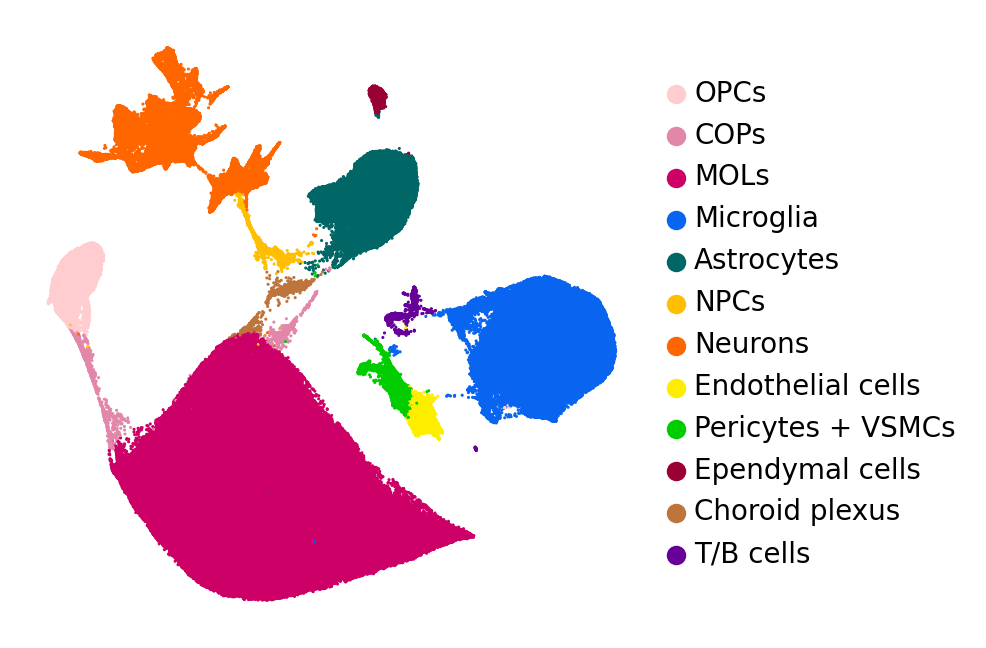

In [16]:
cluster_color = {
    'Microglia': '#0965f0',
    'MOLs': '#cc0066',
    'OPCs': '#ffccd0',
    'COPs': '#e387aa',
    'Astrocytes': '#006666',   
    'NPCs': '#ffbf00',
    'Neurons': '#ff6600',
    'Endothelial cells': '#fdee00',
    'Pericytes + VSMCs': '#00cc00',
    'Ependymal cells': '#990033',
    'Choroid plexus': '#bd743d',
    'T/B cells': '#660099',
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cluster_annotation'], legend_fontsize =float(10) , wspace=0.6, 
           cmap=mymap2,palette=cluster_color, s=5, title='',
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'_celltypes_NEW__MM_sysVI_all.png' )

In [79]:
adata_all.obs[:5]

,sample_id,publication,sample_id_anon,individual_id_anon,replicate,treatment,condition,tissue,time,batch,lesion_type,sample_source,diagnosis,n_genes_by_counts,total_counts,pct_counts_mt,pct_counts_ribo,s_score,g2m_score,phase,type_fine,type_broad,cluster_zoom,exclude_pseudobulk,seq_pool,sex,age_at_death,smoker,cause_of_death,years_w_ms,pmi_minutes,age_scale,age_cat,pmi_cat,pmi_cat2,cell_cycle_diff,cell_type_eval,library_type,sample_type,organism,system,n_counts,treatment_min,system_map,sys_leiden_1,sys_leiden_1.5,sys_leiden_2,cell_type_abbrev,treatment_meta,indiv_treatment_time,pub_treatment_lesion,lesion_status,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,log1p_total_counts_mt,total_counts_ribo,log1p_total_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,S_score,G2M_score,Cycling cells,S phase,Cycling_cells,S_phase_cells,cluster_annotation,cell_leiden_annotated,cell_type_organism,cell.type,study_id
GTATTTCGTCCACATA-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3794,3381.560983,0.030401,0.185391,-0.160523,-0.120577,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.039946,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.241440,8.126388,2.728318,1.028038,0.707069,6.269093,1.983632,0.000000,0.000000,0.000000,-0.153471,-0.112900,-0.134834,-0.156639,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons,Neurons,mouse
ATACCTTGTCGACGCT-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3735,3427.054588,0.000000,0.204575,-0.137565,-0.107280,G1,TBD,inhibitory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.030285,inhibitory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,24,40,47,inh,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.225771,8.139748,2.564834,0.000000,0.000000,7.010889,2.080802,0.000000,0.000000,0.000000,-0.140692,-0.116490,-0.118876,-0.131608,resting,NA,Neurons,24_Neurons,mouse_inhibitory neurons,Neurons,mouse
TCAAGACGTGCTGCAC-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4377,3820.375814,0.054037,0.256314,-0.147916,-0.150035,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.002119,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.384347,8.248366,2.287634,2.064430,1.119862,9.792141,2.378818,0.516108,0.416146,0.013509,-0.115655,-0.122651,-0.123775,-0.119664,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons,Neurons,mouse
AGTACTGTCAAGTAAG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4560,3954.188651,0.039623,0.345452,-0.132352,-0.172023,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.039672,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,12,18,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.425297,8.282784,2.147282,1.566763,0.942646,13.659839,2.685112,0.000000,0.000000,0.000000,-0.108185,-0.147644,-0.128402,-0.106295,resting,NA,Neurons,12_Neurons,mouse_excitatory neurons,Neurons,mouse
TCCCAGTTCCGATGCG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3828,3557.449313,0.054527,0.254129,-0.134222,-0.118009,G1,TBD

In [89]:
lesion_condition_map = {
    'LPC_demyelination': 'LPC_demyel',
    'baseline_mm': 'Baseline_MM',
    'cuprizone_demyelination': 'Cupr_demyel',
    'LPC_late_remyelination': 'LPC_remyel',
    'LPC_early_remyelination': 'LPC_mid',
    'cuprizone_remyelination': 'Cupr_remyel',
    'baseline_hs': 'Baseline_HS',
    'MS_CIL': 'CIL',
    'MS_RL': 'RL',
    'MS_NAWM': 'NAWM',
    'MS_AL': 'AL',
    'MS_CAL': 'CAL',
}

adata_all.obs['lesion_simplified'] = adata_all.obs['lesion_status'].map(lesion_condition_map).astype('category')

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.11.4 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.12


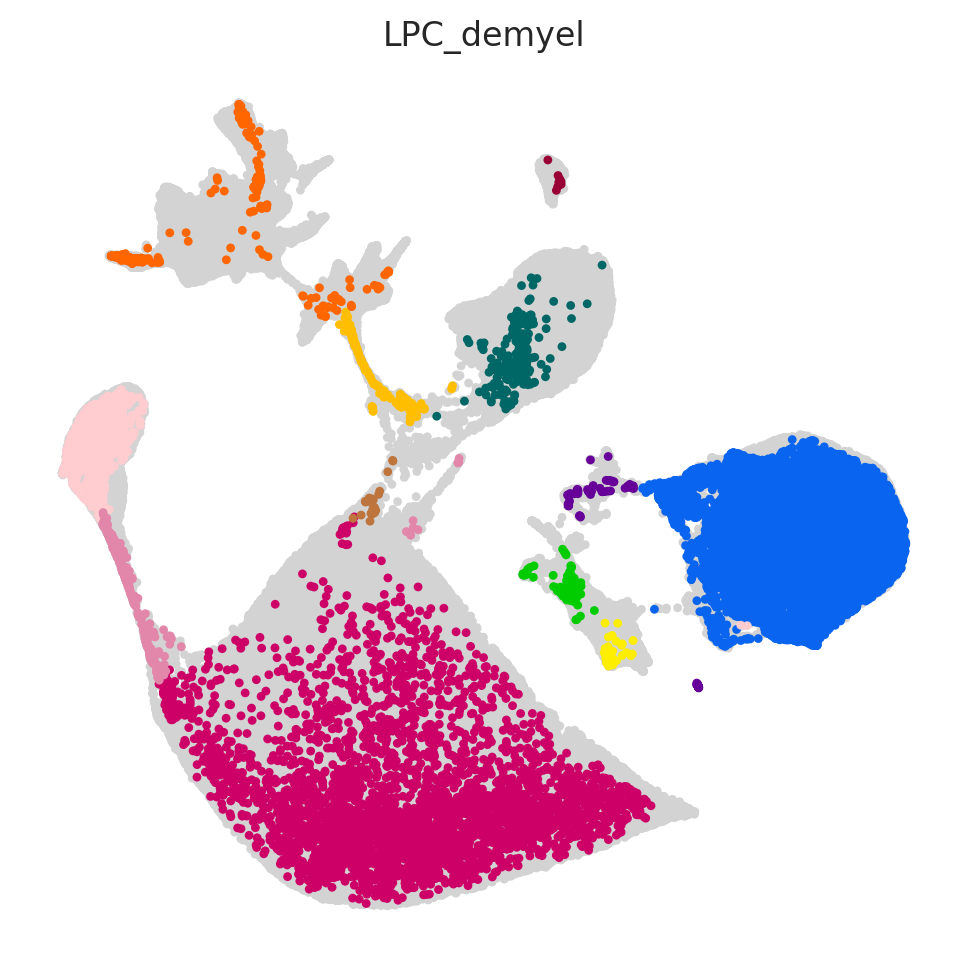

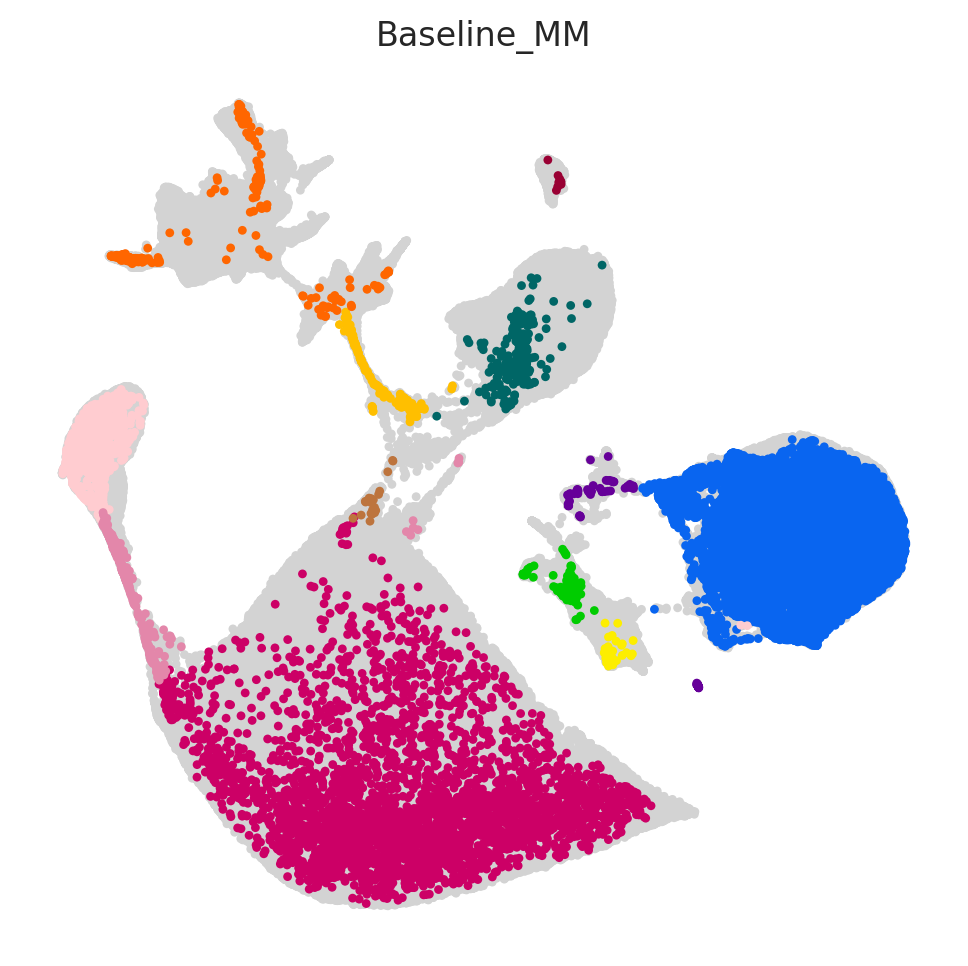

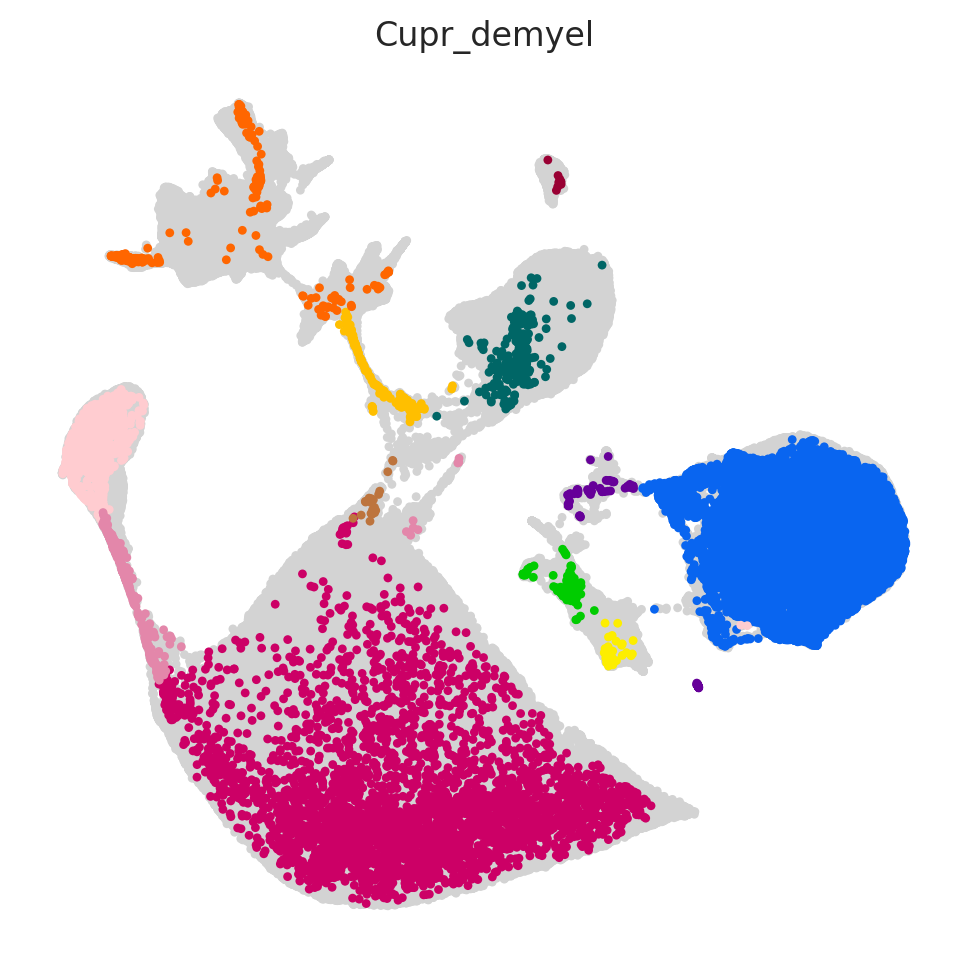

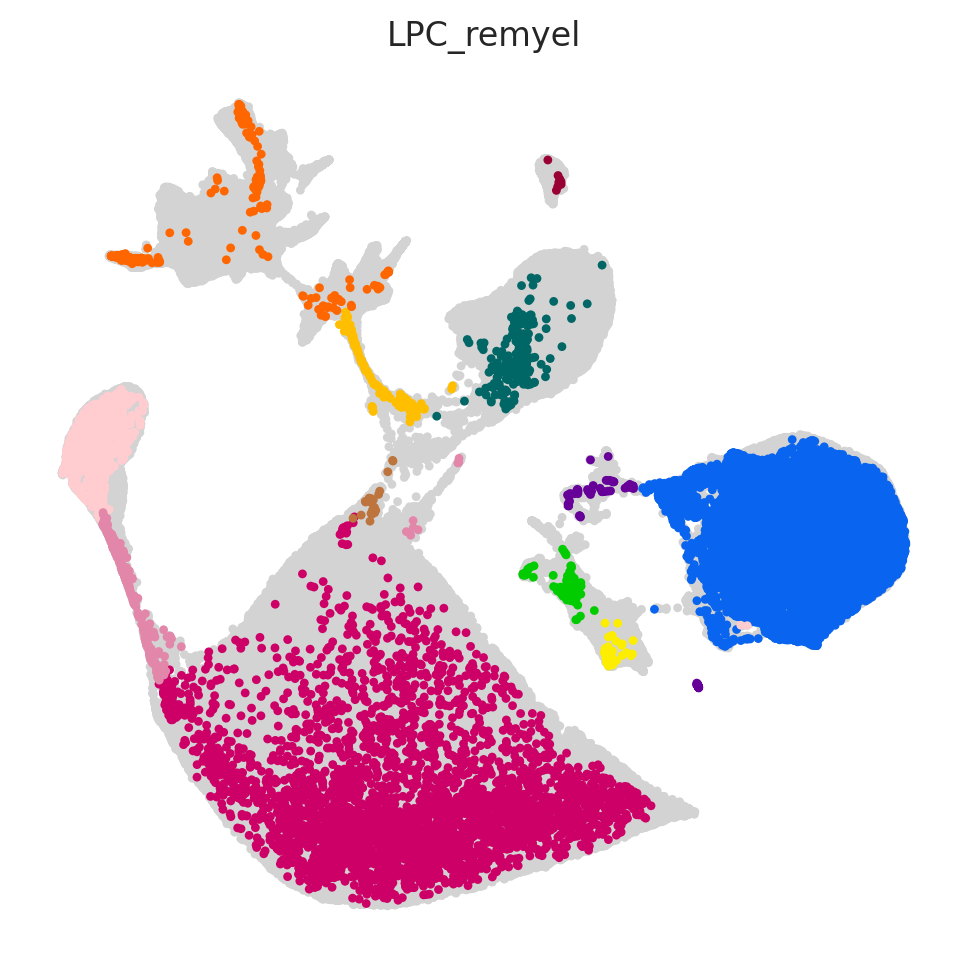

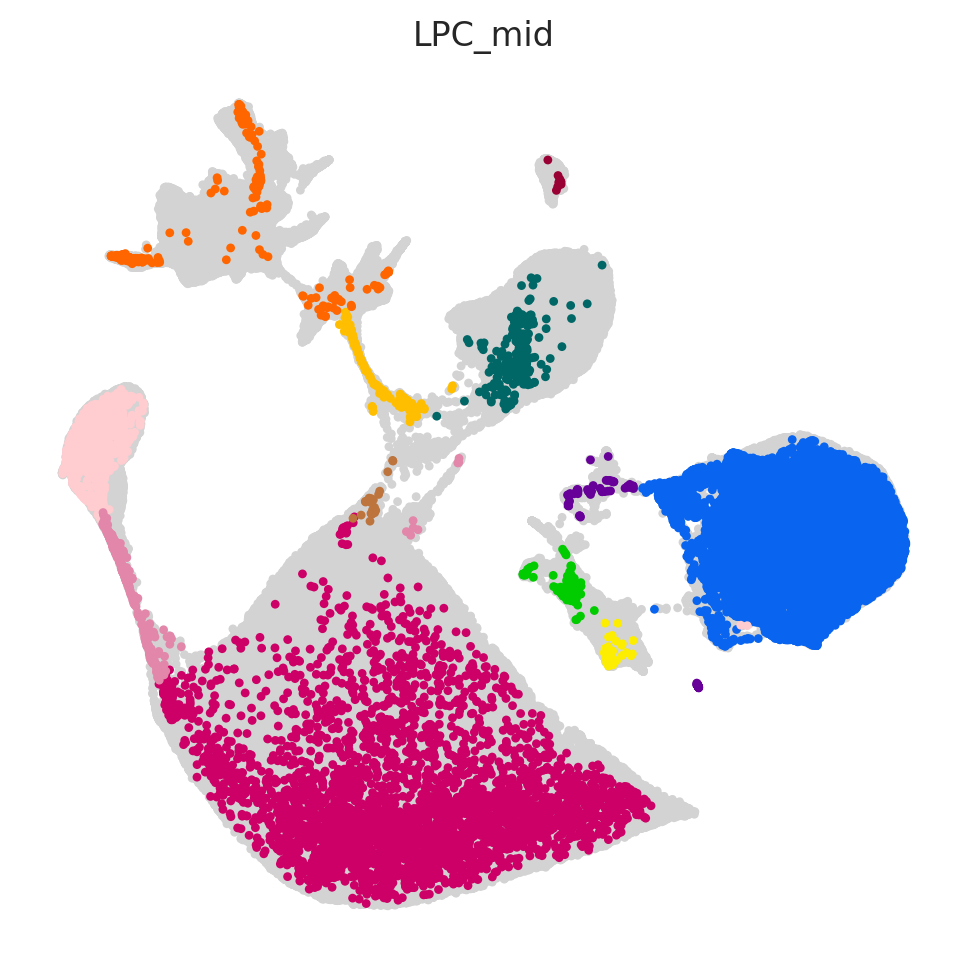

...

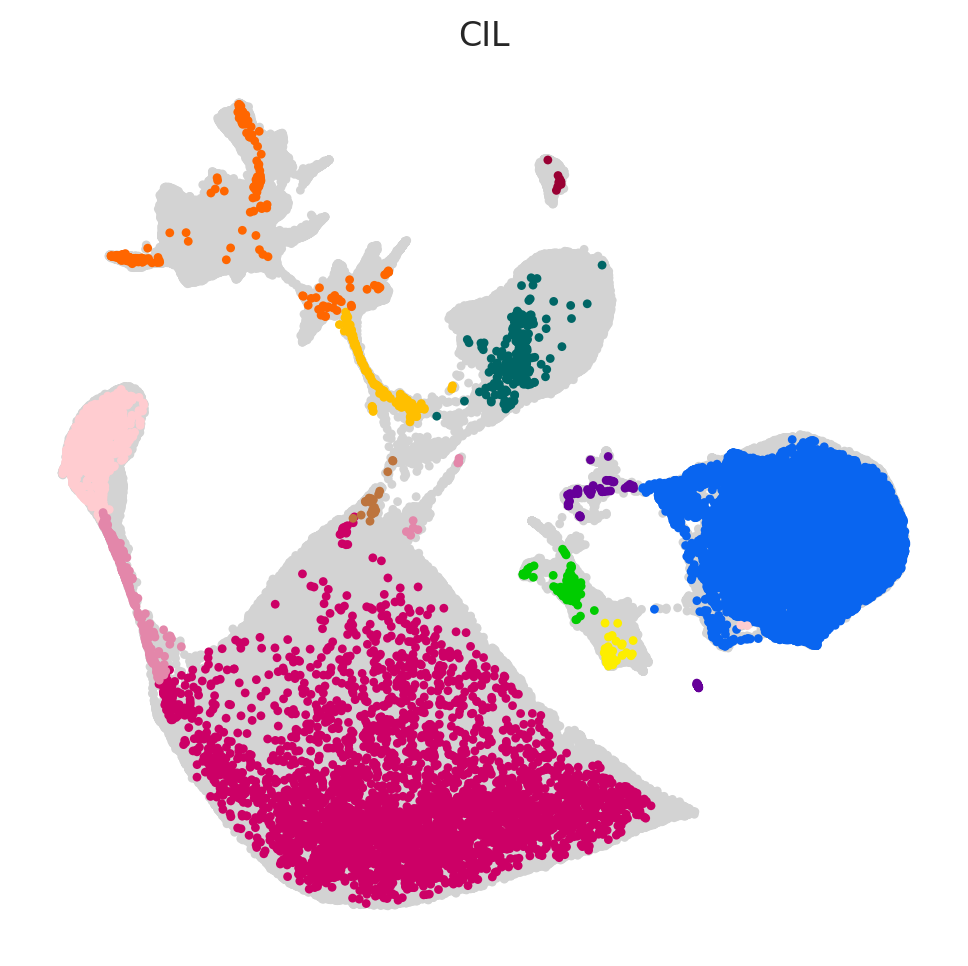

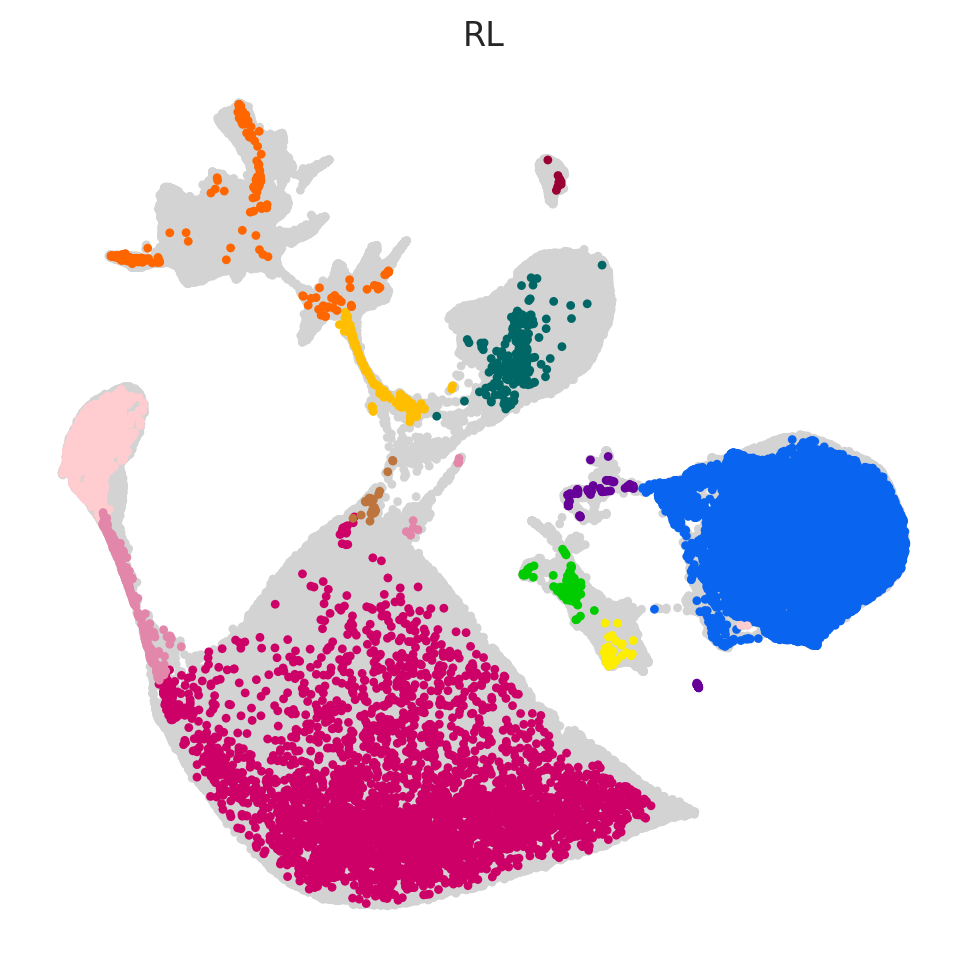

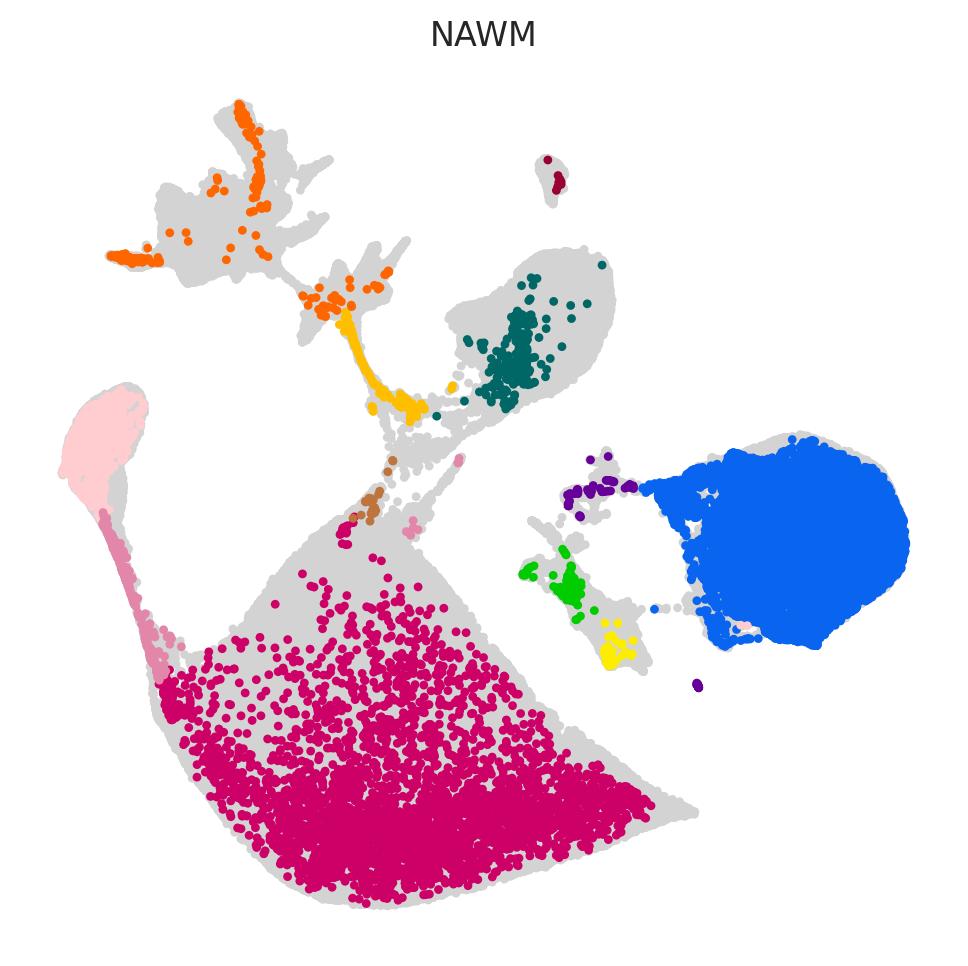

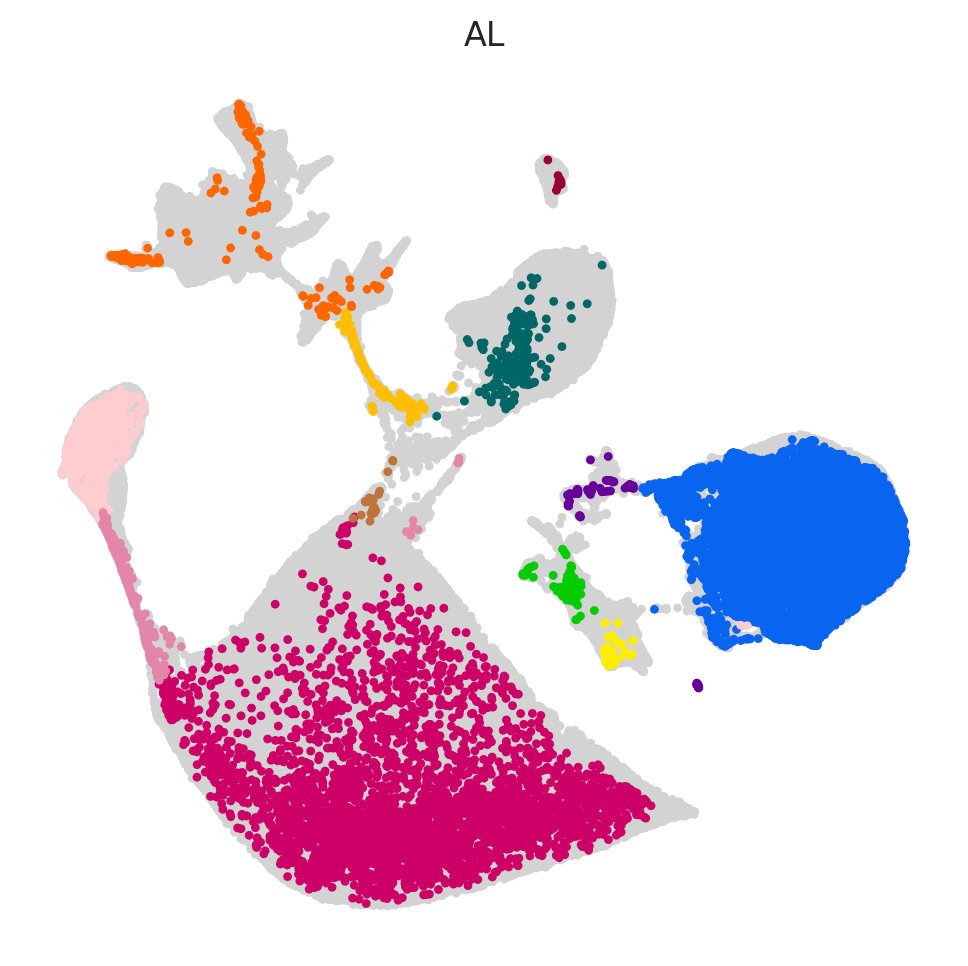

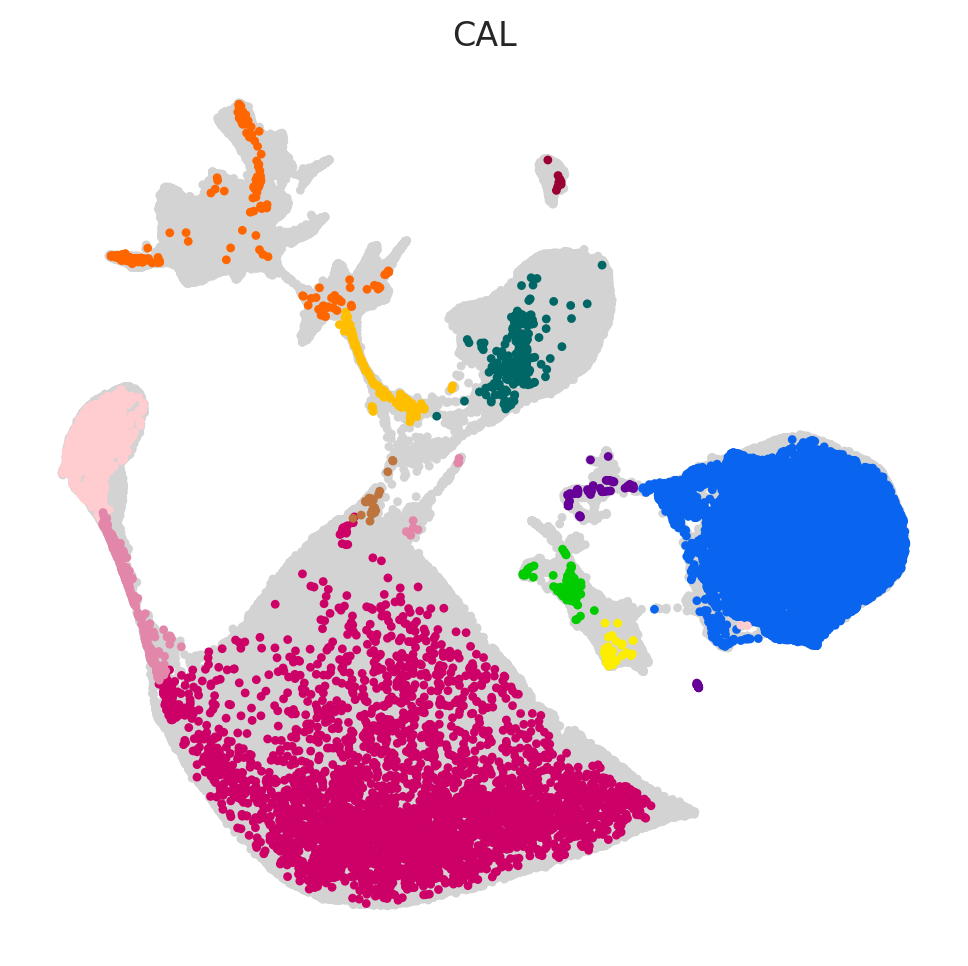

In [94]:
import matplotlib.pyplot as plt
import numpy as np
import scanpy as sc
import os

# Configuration for figure settings
plt.rcParams['figure.figsize'] = (5, 5)  # Set default figure size
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300, transparent=True, fontsize=12)

# Define the output directory and ensure it exists
output_dir = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined/figures/'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Set the directory for saving figures
sc.settings.figdir = output_dir
sc.logging.print_header()

cluster_color = {
    'Microglia': '#0965f0',
    'MOLs': '#cc0066',
    'OPCs': '#ffccd0',
    'COPs': '#e387aa',
    'Astrocytes': '#006666',   
    'NPCs': '#ffbf00',
    'Neurons': '#ff6600',
    'Endothelial cells': '#fdee00',
    'Pericytes + VSMCs': '#00cc00',
    'Ependymal cells': '#990033',
    'Choroid plexus': '#bd743d',
    'T/B cells': '#660099',
}

# Set a grey color for cells not in the current lesion_status
grey_color = '#d3d3d3'

# Iterate over unique lesion_statuses
for lesion_simplified in adata_all.obs['lesion_simplified'].unique():
    # Create a mask for cells in the specific lesion_status
    lesion_mask = adata_all.obs['lesion_simplified'] == lesion_status

    # Initialize color vector for cells not in the lesion_status
    colors = np.array([grey_color] * adata_all.shape[0])  # Initialize all to grey

    # Plot UMAP with grey dots first
    plt.figure(figsize=(5, 5))  # Ensure figure size matches settings
    umap_coords = adata_all.obsm['X_umap']
    grey_mask = ~lesion_mask
    plt.scatter(umap_coords[grey_mask, 0], umap_coords[grey_mask, 1], 
                color=grey_color, s=10, edgecolor='none')

    # Overlay cell type colors on top
    for cell_type in cluster_color:
        # Assign the specific cluster color for cells of the current type in the lesion_status
        cell_type_mask = (adata_all.obs['cluster_annotation'] == cell_type) & lesion_mask
        plt.scatter(umap_coords[cell_type_mask, 0], umap_coords[cell_type_mask, 1], 
                    color=cluster_color[cell_type], s=10, edgecolor='none')

    # Customize plot appearance
    plt.title(f"{lesion_simplified}", fontsize=12)  # Ensure title is added with fontsize
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    
    # Remove grid and axes
    plt.grid(False)
    plt.gca().set_axis_off()

    # Save the plot with specified parameters
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{lesion_simplified}_combined_umap.png"), dpi=300, transparent=True)

    # Show the plot in the console
    plt.show()

    # Close the plot
    plt.close()

In [117]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['publication'].unique()
for condition in unique_conditions:
    print(condition)

(this study)

Pandey et al. 2022

Shen et al. 2021

Macnair et al. biorxiv

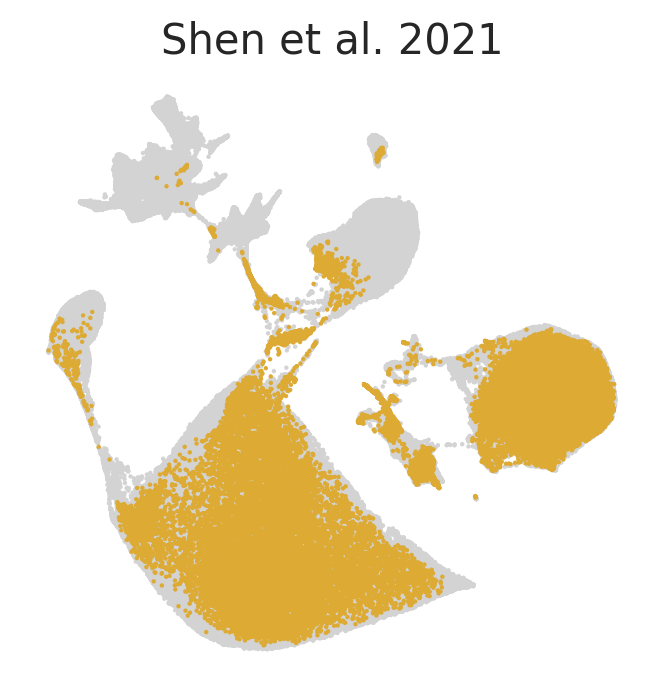

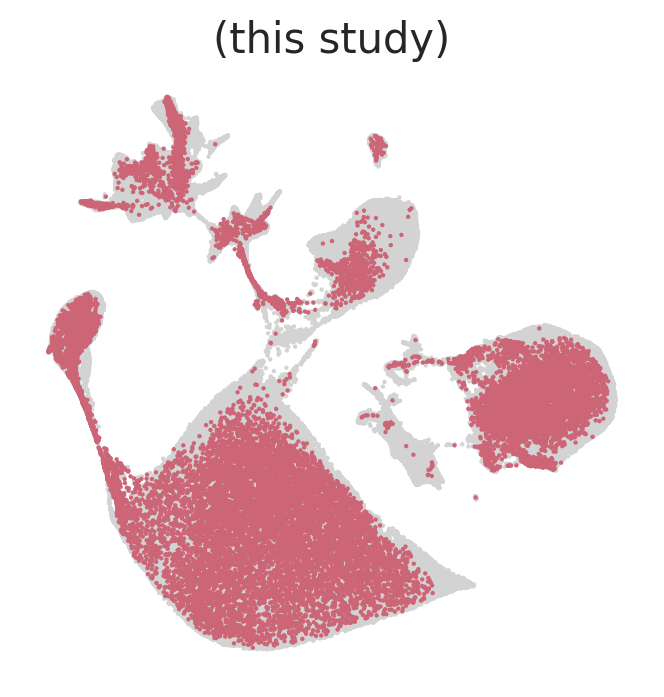

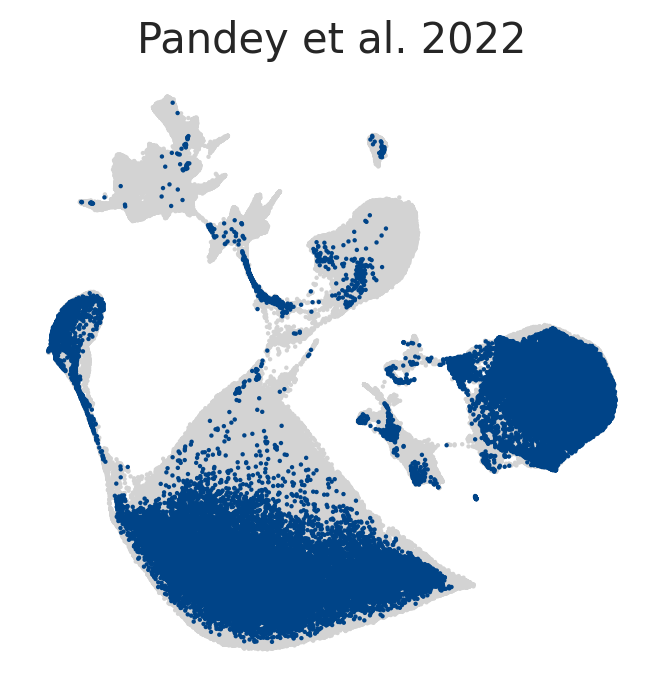

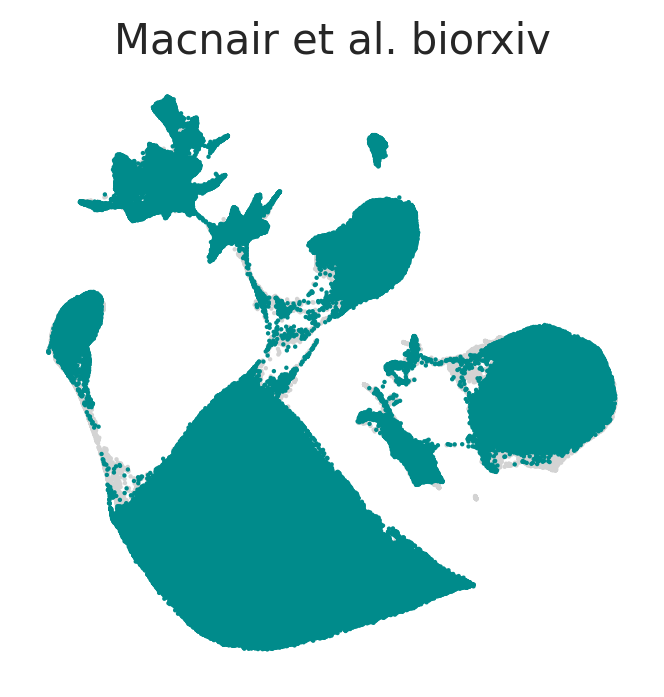

In [118]:
# Define custom colors for the publications
publication_colors = {
    '(this study)': '#CC6677', 
    'Pandey et al. 2022': '#004488', 
    'Shen et al. 2021': '#DDAA33',  
    'Macnair et al. biorxiv': '#008b8b', 
}

# Plot UMAP for each publication with custom colors
for i in set(adata_all.obs['publication']):
    sc.pl.umap(
        adata_all, 
        color='publication', 
        legend_fontweight='normal', 
        s=10,
        frameon=False, 
        groups=[i], 
        palette=publication_colors,
        title=i,  # Set the title to the publication name
        legend_loc=None,  # Turn off the legend
        save=i+'_publication.png'
    )

In [7]:
adata_all.obs['cell_type_organism'] = adata_all.obs['organism'].astype(str) + '_' + adata_all.obs['cell_type_eval'].astype(str)

In [8]:
pd.set_option('display.max_columns', 500)
adata_all.obs[:5]

,sample_id,publication,sample_id_anon,individual_id_anon,replicate,treatment,condition,tissue,time,batch,lesion_type,sample_source,diagnosis,n_genes_by_counts,total_counts,pct_counts_mt,pct_counts_ribo,s_score,g2m_score,phase,type_fine,type_broad,cluster_zoom,exclude_pseudobulk,seq_pool,sex,age_at_death,smoker,cause_of_death,years_w_ms,pmi_minutes,age_scale,age_cat,pmi_cat,pmi_cat2,cell_cycle_diff,cell_type_eval,library_type,sample_type,organism,system,n_counts,treatment_min,system_map,sys_leiden_1,sys_leiden_1.5,sys_leiden_2,cell_type_abbrev,treatment_meta,indiv_treatment_time,pub_treatment_lesion,lesion_status,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,log1p_total_counts_mt,total_counts_ribo,log1p_total_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,S_score,G2M_score,Cycling cells,S phase,Cycling_cells,S_phase_cells,cluster_annotation,cell_leiden_annotated,cell_type_organism
GTATTTCGTCCACATA-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3794,3381.560983,0.030401,0.185391,-0.160523,-0.120577,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.039946,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.241440,8.126388,2.728318,1.028038,0.707069,6.269093,1.983632,0.000000,0.000000,0.000000,-0.153471,-0.112900,-0.134834,-0.156639,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons
ATACCTTGTCGACGCT-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3735,3427.054588,0.000000,0.204575,-0.137565,-0.107280,G1,TBD,inhibitory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.030285,inhibitory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,24,40,47,inh,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.225771,8.139748,2.564834,0.000000,0.000000,7.010889,2.080802,0.000000,0.000000,0.000000,-0.140692,-0.116490,-0.118876,-0.131608,resting,NA,Neurons,24_Neurons,mouse_inhibitory neurons
TCAAGACGTGCTGCAC-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4377,3820.375814,0.054037,0.256314,-0.147916,-0.150035,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.002119,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.384347,8.248366,2.287634,2.064430,1.119862,9.792141,2.378818,0.516108,0.416146,0.013509,-0.115655,-0.122651,-0.123775,-0.119664,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons
AGTACTGTCAAGTAAG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4560,3954.188651,0.039623,0.345452,-0.132352,-0.172023,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.039672,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,12,18,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.425297,8.282784,2.147282,1.566763,0.942646,13.659839,2.685112,0.000000,0.000000,0.000000,-0.108185,-0.147644,-0.128402,-0.106295,resting,NA,Neurons,12_Neurons,mouse_excitatory neurons
TCCCAGTTCCGATGCG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3828,3557.449313,0.054527,0.254129,-0.134222,-0.118009,G1,TBD,inhibitory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,

# AUROC METACELL TEST

In [13]:
import os
import tempfile

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import rcParams
from matplotlib import cm, colors
import scanpy as sc
import pandas as pd
import seaborn as sns
import scipy as sp
import numpy as np
import torch
from rich import print

import pymn


# Define the path to the directory you want to change to
new_directory = '/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/'

# Use os.chdir() to change the working directory
os.chdir(new_directory)

In [104]:
#These save characters as text in PDFs
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

#These change plot aesthetics

sns.set(style='white', font_scale=1.25)
plt.rc("axes.spines", top=False, right=False)
plt.rc('xtick', bottom=True)
plt.rc('ytick', left=True)

In [95]:
adata_all.obs['cell.type'] = adata_all.obs['cluster_annotation'].astype(str)
adata_all.obs['study_id'] = adata_all.obs['organism'].astype(str)

organism             human  mouse
cluster_annotation               
OPCs                 12523   3004
COPs                   889   1109
MOLs                188318  41045
Microglia            38081  53415
Astrocytes           37777   1605
NPCs                   778   2182
Neurons              31416   3113
Endothelial cells     3758   1563
Pericytes + VSMCs     3851   2731
Ependymal cells       1326    193
Choroid plexus         350   1657
T/B cells             2499    400

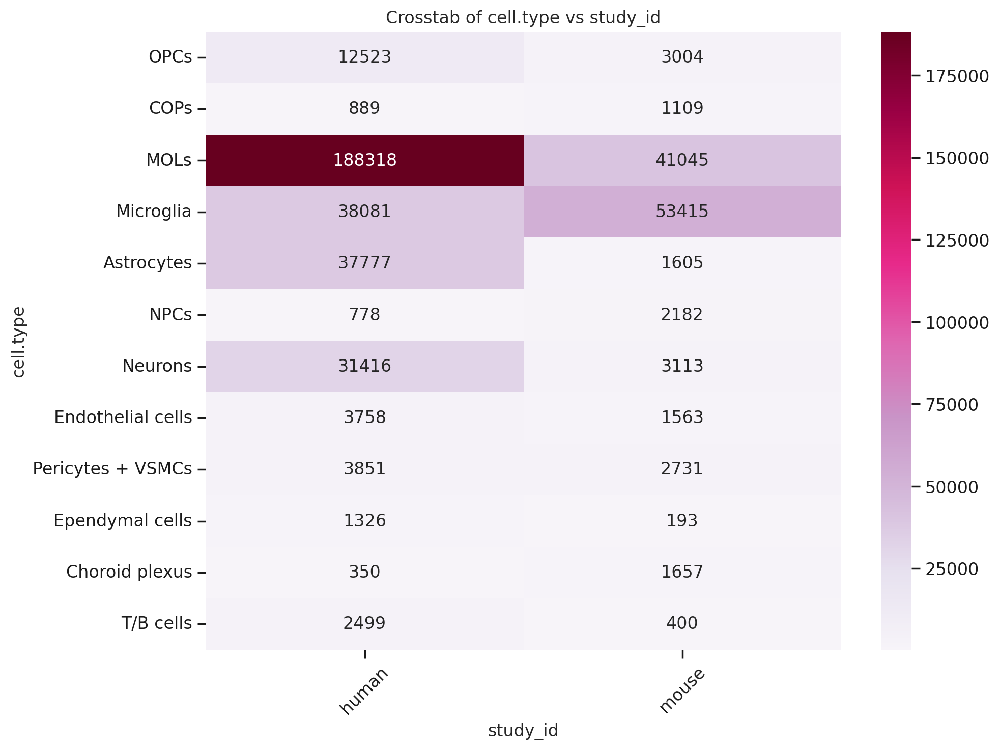

In [96]:
# Create a crosstab
crosstab = pd.crosstab(adata_all.obs['cluster_annotation'], adata_all.obs['organism'])

# Display the crosstab
print(crosstab)

# Visualize the crosstab with a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(crosstab, annot=True, fmt="d", cmap="PuRd")
plt.title('Crosstab of cell.type vs study_id')
plt.xlabel('study_id')
plt.ylabel('cell.type')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

In [97]:
adata_all.obs['study_id'] = adata_all.obs['organism'].astype(str)

In [98]:
# Read the hvg_genes list from the text file
with open('hvg_genes.txt', 'r') as f:
    hvg_genes = [line.strip() for line in f]

# Confirm the first few gene names
print(hvg_genes[:5])

['SNX24', 'FAM49A', 'KHDRBS3', 'MSR1', 'CACNA1D']

In [99]:
# Subset adata_all to include only the highly variable genes
adata_hvg = adata_all[:, hvg_genes]

# Display the dimensions of the new subset
print(adata_hvg)

View of AnnData object with n_obs × n_vars = 433583 × 2904
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition',
'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 
'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 
'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 
'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 
'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 
'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 
'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 
'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'total_counts_hb', 
'log1p_total_counts_hb', 'pct_counts_hb', 'S_score', 'G2M_score', 'Cycling cells', 'S phase', 'Cycling_cells', 
'S_phase_cells', 'cluster_annotation', 'cell_leiden_annotated', 'cell_type_organism', 'cell.type', 'study_id', 
'lesion_simplified'
    var: 'mt', 'hb', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 
'total_counts', 'log1p_total_counts'
    uns: 'Cycling_cells_colors', 'S_phase_cells_colors', '_scvi_manager_uuid', '_scvi_uuid', 
'cell_leiden_annotated_colors', 'cell_type_eval_colors', 'cluster_annotation_colors', 'covariate_categ_orders', 
'covariate_key_orders', 'layer_information', 'leiden', 'neighbors', 'phase_colors', 'publication_colors', 
'sys_leiden_1_colors', 'sys_leiden_2_colors', 'system_order', 'type_fine_colors', 'umap'
    obsm: 'X_sysVI', 'X_umap', 'covariates', 'system'
    layers: 'counts', 'log1p_norm'
    obsp: 'connectivities', 'distances'

In [100]:
adata_hvg.obs[:5]

,sample_id,publication,sample_id_anon,individual_id_anon,replicate,treatment,condition,tissue,time,batch,lesion_type,sample_source,diagnosis,n_genes_by_counts,total_counts,pct_counts_mt,pct_counts_ribo,s_score,g2m_score,phase,type_fine,type_broad,cluster_zoom,exclude_pseudobulk,seq_pool,sex,age_at_death,smoker,cause_of_death,years_w_ms,pmi_minutes,age_scale,age_cat,pmi_cat,pmi_cat2,cell_cycle_diff,cell_type_eval,library_type,sample_type,organism,system,n_counts,treatment_min,system_map,sys_leiden_1,sys_leiden_1.5,sys_leiden_2,cell_type_abbrev,treatment_meta,indiv_treatment_time,pub_treatment_lesion,lesion_status,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mt,log1p_total_counts_mt,total_counts_ribo,log1p_total_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,S_score,G2M_score,Cycling cells,S phase,Cycling_cells,S_phase_cells,cluster_annotation,cell_leiden_annotated,cell_type_organism,cell.type,study_id,lesion_simplified
GTATTTCGTCCACATA-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3794,3381.560983,0.030401,0.185391,-0.160523,-0.120577,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.039946,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.241440,8.126388,2.728318,1.028038,0.707069,6.269093,1.983632,0.000000,0.000000,0.000000,-0.153471,-0.112900,-0.134834,-0.156639,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons,Neurons,mouse,LPC_demyel
ATACCTTGTCGACGCT-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,3735,3427.054588,0.000000,0.204575,-0.137565,-0.107280,G1,TBD,inhibitory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,-0.030285,inhibitory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,24,40,47,inh,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.225771,8.139748,2.564834,0.000000,0.000000,7.010889,2.080802,0.000000,0.000000,0.000000,-0.140692,-0.116490,-0.118876,-0.131608,resting,NA,Neurons,24_Neurons,mouse_inhibitory neurons,Neurons,mouse,LPC_demyel
TCAAGACGTGCTGCAC-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4377,3820.375814,0.054037,0.256314,-0.147916,-0.150035,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.002119,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,22,25,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.384347,8.248366,2.287634,2.064430,1.119862,9.792141,2.378818,0.516108,0.416146,0.013509,-0.115655,-0.122651,-0.123775,-0.119664,resting,NA,Neurons,22_Neurons,mouse_excitatory neurons,Neurons,mouse,LPC_demyel
AGTACTGTCAAGTAAG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination,4560,3954.188651,0.039623,0.345452,-0.132352,-0.172023,G1,TBD,excitatory neurons,TBD,False,None,mixed,1,non-smoker,sacrificed,0.0,0.0,0,adult,None,None,0.039672,excitatory neurons,10X 3p kit v3.1,sn,mouse,0,NaN,Demyelination,sn-mouse,12,18,28,ex,Demyelination,(this study)_LPC_Demyelination,(this study)_LPC_Demyelination,LPC_demyelination,8.425297,8.282784,2.147282,1.566763,0.942646,13.659839,2.685112,0.000000,0.000000,0.000000,-0.108185,-0.147644,-0.128402,-0.106295,resting,NA,Neurons,12_Neurons,mouse_excitatory neurons,Neurons,mouse,LPC_demyel
TCCCAGTTCCGATGCG-1_adams_mouse,cl2,(this study),adams_Sample6_2,adams_Sample6,2,LPC,Demyelination,Corpus callosum,7dpl,6,Demyelination,(this study),Demyelination

In [101]:
adata_hvg.var['highly_variable'] = True
adata_hvg.var[:5]

/tmp/823967.1.gpu/ipykernel_4016480/3721582344.py:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata_hvg.var['highly_variable'] = True


,mt,hb,ribo,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,highly_variable
SNX24,False,False,False,140884,0.434087,0.360528,67.507029,188212.743201,12.145334,True
FAM49A,False,False,False,91150,0.271571,0.240253,78.977497,117748.566010,11.676315,True
KHDRBS3,False,False,False,108303,0.399758,0.336299,75.021392,173328.267754,12.062948,True
MSR1,False,False,False,37331,0.153572,0.142863,91.390114,66586.047363,11.106265,True
CACNA1D,False,False,False,87916,0.301019,0.263148,79.723375,130516.609254,11.779263,True


In [102]:
pymn.MetaNeighborUS(adata_hvg,
                    study_col='study_id',
                    ct_col='cell.type',
                    fast_version=True,
                    symmetric_output=False,
                    one_vs_best=True)

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/seaborn/matrix.py:1124: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


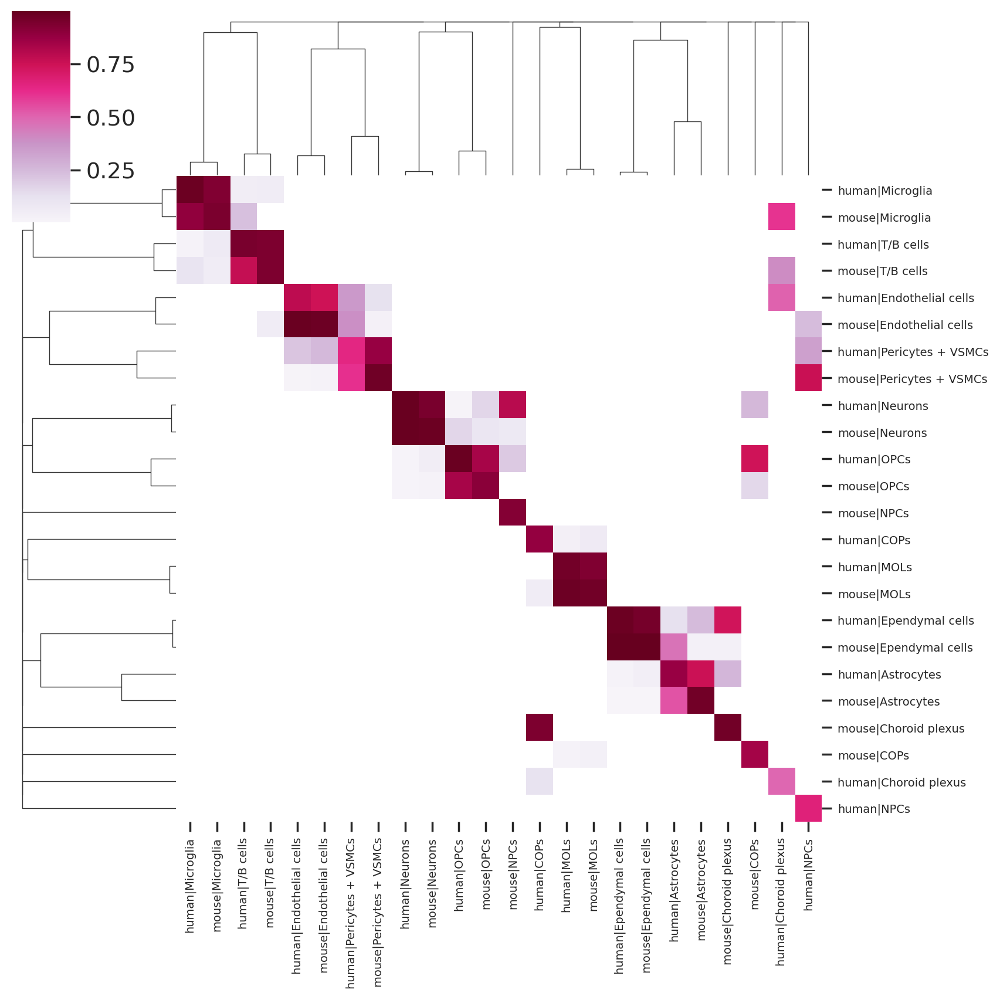

In [105]:
pymn.plotMetaNeighborUS(adata_hvg,
                        cmap='PuRd',
                        figsize=(10, 10),
                        mn_key='MetaNeighborUS_1v1',
                        xticklabels=True,
                        yticklabels=True,
                        fontsize=7)

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/seaborn/matrix.py:1124: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


<Figure size 1000x1000 with 0 Axes>

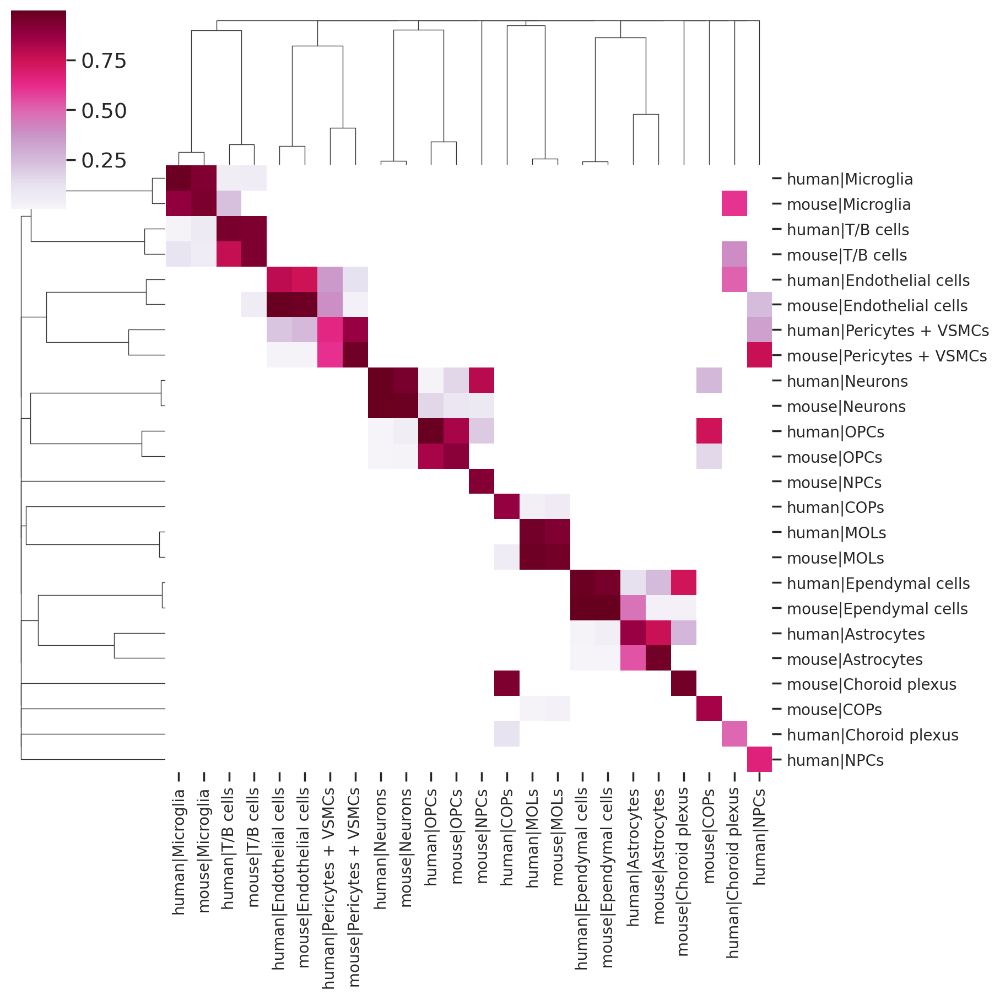

In [116]:
# Set up figure and plot MetaNeighborUS heatmap
plt.figure(figsize=(10, 10))

# Plot MetaNeighborUS heatmap
pymn.plotMetaNeighborUS(adata_hvg,
                        cmap='PuRd',
                        figsize=(10, 10),
                        mn_key='MetaNeighborUS_1v1',
                        xticklabels=True,
                        yticklabels=True,
                        fontsize=10,
                        show=False
                        )

# Get current figure and save it
fig = plt.gcf()
fig.savefig('MetaNeighborUS_high_res_plot.pdf', dpi=300, bbox_inches='tight')
fig.savefig('MetaNeighborUS_high_res_plot.png', dpi=300, bbox_inches='tight')

# Show the plot (optional)
plt.show()

# QC TESTING!

         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:08:21)
Storing dendrogram info using `.uns['dendrogram_cell_type_organism']`


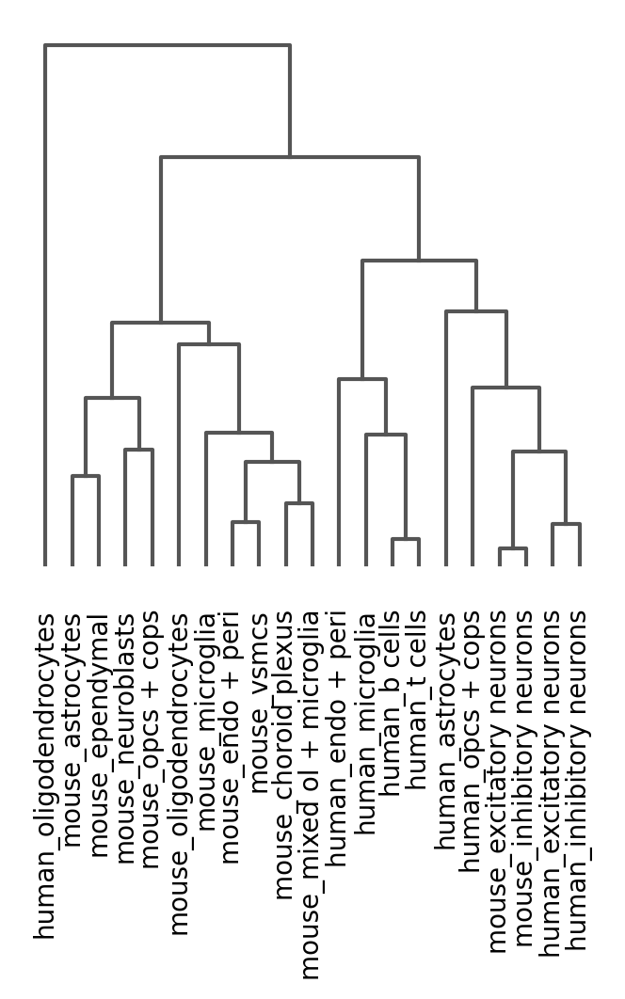

<Axes: >

In [13]:
# Ensure the column is of categorical type
adata_all.obs['cell_type_organism'] = adata_all.obs['cell_type_organism'].astype('category')


sc.tl.dendrogram(adata_all, 'cell_type_organism')
sc.pl.dendrogram(adata_all, 'cell_type_organism')

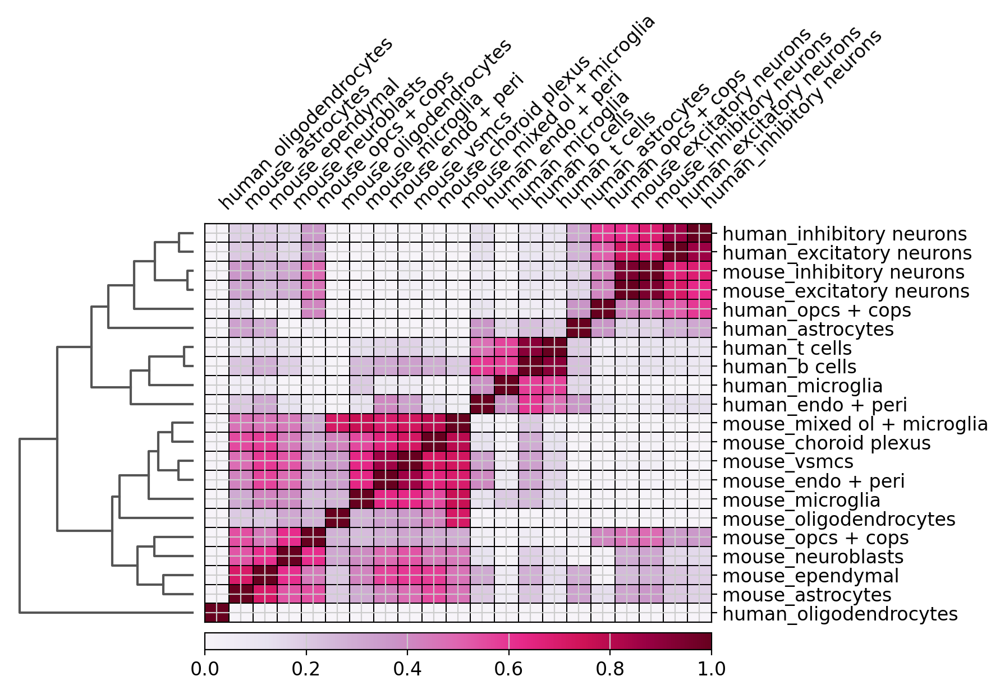

In [14]:
ax = sc.pl.correlation_matrix(adata_all, "cell_type_organism", figsize=(8, 5),color='black', vmin=0, cmap='PuRd') #save=today+'correlation_matrix.pdf')

In [5]:
# Split the dataset into human and mouse
adata_human = adata_all[adata_all.obs['organism'] == 'human'].copy()

In [46]:
# Find marker genes for each cell type
sc.tl.rank_genes_groups(adata_human, 'cell_type_eval', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:22:31)


In [6]:
adata_mouse = adata_all[adata_all.obs['organism'] == 'mouse'].copy()

In [47]:
sc.tl.rank_genes_groups(adata_mouse, 'cell_type_eval', method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:04:26)


In [48]:
# Extract marker genes
human_markers = {cell_type: adata_human.uns['rank_genes_groups']['names'][cell_type][:100] for cell_type in adata_human.obs['cell_type_eval'].unique()}
mouse_markers = {cell_type: adata_mouse.uns['rank_genes_groups']['names'][cell_type][:100] for cell_type in adata_mouse.obs['cell_type_eval'].unique()}

In [82]:
result = adata_human.uns['rank_genes_groups']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

adata_annotated_genes.to_csv('./h2m_adata_HUMAN_cell_type_eval_rank_genes.csv')

In [83]:
result = adata_mouse.uns['rank_genes_groups']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

adata_annotated_genes.to_csv('./h2m_adata_MOUSE_cell_type_eval_rank_genes.csv')

In [49]:
human_markers

{'oligodendrocytes': array(['CTNNA3', 'IL1RAPL1', 'ST18', 'SLC44A1', 'RNF220', 'PIP4K2A',
        'PLP1', 'MAP7', 'EDIL3', 'TMEM144', 'MBP', 'TMTC2', 'SLC24A2',
        'TF', 'ZNF536', 'PRUNE2', 'DNM3', 'ENPP2', 'PCDH9', 'CLMN',
        'PHLPP1', 'TTLL7', 'SHTN1', 'C10orf90', 'FRMD5', 'SPOCK3', 'ABCA2',
        'MOBP', 'ATP8A1', 'MAN2A1', 'PEX5L', 'AC026316.4', 'PLCL1',
        'CNTN2', 'TMEM165', 'PTPRK', 'DOCK5', 'UNC5C', 'PXK', 'PCSK6',
        'QKI', 'MAGI2', 'SLAIN1', 'PLEKHH1', 'SPOCK1', 'SH3GL3', 'DNAJC6',
        'FRYL', 'FRMD4B', 'GPM6B', 'PDE4B', 'DOCK10', 'SIK3', 'MOG',
        'KCNH8', 'CLASP2', 'PDE1C', 'TRIM2', 'NKAIN2', 'MYRF', 'FA2H',
        'CLDND1', 'CDK18', 'AGAP1', 'UGT8', 'SEPT7', 'CNP', 'CERCAM',
        'POLR2F', 'AMER2', 'SLCO1A2', 'FAM107B', 'CNTNAP4', 'LIMCH1',
        'DLG1', 'KLHL32', 'ELMO1', 'GRM3', 'ANLN', 'PTPRD', 'GAB1',
        'KIRREL3', 'ABCA8', 'SYNJ2', 'SHROOM4', 'MARCH1', 'SLCO3A1',
        'APLP1', 'ARAP2', 'CD22', 'CREB5', 'BCAS1', 'DLG2', 'OTU

In [50]:
mouse_markers

{'excitatory neurons': array(['NRG3', 'MEG3', 'DLG2', 'SYT1', 'CELF2', 'FGF14', 'CSMD1', 'ASIC2',
        'RBFOX1', 'FAM155A', 'NRXN1', 'ADGRB3', 'KALRN', 'GRIN2B', 'PTPRD',
        'FRMPD4', 'KCNIP4', 'SNHG11', 'PHACTR1', 'DPP10', 'NRG1', 'NRXN3',
        'OPCML', 'GRIA2', 'ARPP21', 'PDE4D', 'KCNMA1', 'GABRB3', 'RIMS1',
        'LRRC7', 'ERC2', 'NEGR1', 'DLGAP2', 'MDGA2', 'MYT1L', 'FGF12',
        'PCSK2', 'CTNND2', 'CACNA1E', 'CCSER1', 'ANKS1B', 'SNAP25',
        'MACROD2', 'SGCZ', 'ETL4', 'DLGAP1', 'RYR2', 'KCNH7', 'NRG3OS',
        'KCND2', 'MMP16', 'STRBP', 'CNTNAP2', 'KHDRBS3', 'GM20642',
        'CADM2', 'CADPS', 'DMD', 'CELF4', 'SNHG14', 'PDE1A', 'AGBL4',
        'GRIA3', 'NAV3', 'HS3ST4', 'MGAT4C', 'GRM5', 'CDH18', 'ADGRL3',
        'GRIA1', 'RIMS2', 'SAMD12', 'STXBP5L', 'DCLK1', 'GM26871', 'PBX1',
        'MCTP1', 'GABRB1', 'UBE3A', 'NLGN1', 'RALYL', 'TENM2', 'XKR4',
        'GABRG3', 'PLCB1', 'MAPK10', 'RIAN', 'CHRM3', 'PRKCE', 'LSAMP',
        'A830018L16RIK', 'CSMD2', 'GRI

In [51]:
# Extract genes for human astrocytes and mouse inhibitory neurons
human_genes_astros = human_markers['astrocytes']
mouse_genes_inhibitory = mouse_markers['inhibitory neurons']

# Find common genes between human astrocytes and mouse inhibitory neurons
common_genes = set(human_genes_astros).intersection(mouse_genes_inhibitory)

# Print or use the common genes as needed
print(f"Common genes between human astrocytes and mouse inhibitory neurons: {common_genes}")

Common genes between human astrocytes and mouse inhibitory neurons: {'CTNNA2', 'NRG3', 'RORA', 'CTNND2', 'DCLK1', 
'LSAMP'}

In [52]:
# Extract genes for human astrocytes and mouse inhibitory neurons
human_genes_astros = human_markers['astrocytes']
mouse_genes_astros = mouse_markers['astrocytes']

# Find common genes between human astrocytes and mouse inhibitory neurons
common_genes = set(human_genes_astros).intersection(mouse_genes_astros)

# Print or use the common genes as needed
print(f"Common genes between human and mouse astrocytes: {common_genes}")

Common genes between human and mouse astrocytes: {'NTRK2', 'GPM6A', 'GJA1', 'PTPRZ1', 'DTNA', 'FMN2', 'PITPNC1', 
'CLU', 'SPARCL1', 'RORA', 'SOX6', 'CTNND2', 'MIR99AHG', 'LSAMP', 'MALAT1', 'NPAS3', 'BMPR1B', 'ATP1A2', 'SLC1A2', 
'NEBL', 'DCLK1', 'AQP4', 'SFXN5', 'MACF1', 'NRCAM', 'CPE', 'MSI2'}

In [53]:
# Extract genes for human astrocytes and mouse inhibitory neurons
human_genes_micro = human_markers['microglia']
mouse_genes_micro = mouse_markers['microglia']

# Find common genes between human astrocytes and mouse inhibitory neurons
common_genes = set(human_genes_micro).intersection(mouse_genes_micro)

# Print or use the common genes as needed
print(f"Common genes between human and mouse microglia: {common_genes}")

Common genes between human and mouse microglia: {'TGFBR1', 'LYN', 'INPP5D', 'LAPTM5', 'CTSB', 'LRMDA', 'APOE', 
'CSF1R', 'PTPRC', 'RUNX1', 'MEF2C', 'LPCAT2', 'SAT1', 'APBB1IP', 'LY86', 'SRGN'}

In [56]:
# Create a matrix to store similarity scores
similarity_matrix = pd.DataFrame(index=adata_human.obs['cell_type_eval'].unique(), columns=adata_mouse.obs['cell_type_eval'].unique())

# Calculate similarity using Pearson correlation
for human_cell_type in human_markers:
    for mouse_cell_type in mouse_markers:
        human_genes = human_markers[human_cell_type]
        mouse_genes = mouse_markers[mouse_cell_type]

        # Find common genes
        common_genes = set(human_genes).intersection(mouse_genes)
        
        if len(common_genes) < 10:  # Need at least 2 genes for meaningful correlation
            similarity_matrix.loc[human_cell_type, mouse_cell_type] = np.nan  # Or some other placeholder value
            continue
        
        try:
            human_expression = adata_human[:, list(common_genes)].X.mean(axis=0)
            mouse_expression = adata_mouse[:, list(common_genes)].X.mean(axis=0)

            # Check if expressions have non-zero variance
            if np.all(np.std(human_expression) == 0) or np.all(np.std(mouse_expression) == 0):
                similarity_matrix.loc[human_cell_type, mouse_cell_type] = np.nan
            else:
                similarity_matrix.loc[human_cell_type, mouse_cell_type] = np.corrcoef(human_expression, mouse_expression)[0, 1]
        except Exception as e:
            print(f"Error computing correlation for {human_cell_type} and {mouse_cell_type}: {e}")
            similarity_matrix.loc[human_cell_type, mouse_cell_type] = np.nan

# Fill NaN with 0 for visualization
similarity_matrix = similarity_matrix.fillna(0)

# Output the similarity matrix
print(similarity_matrix)

/tmp/ipykernel_90032/489314023.py:31: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  similarity_matrix = similarity_matrix.fillna(0)


excitatory neurons  inhibitory neurons  oligodendrocytes  \
oligodendrocytes              0.000000            0.000000          0.502486   
microglia                     0.000000            0.000000          0.000000   
astrocytes                    0.000000            0.000000          0.000000   
endo + peri                   0.000000            0.000000          0.000000   
inhibitory neurons            0.295544            0.348519          0.000000   
excitatory neurons            0.627788            0.601959          0.000000   
opcs + cops                   0.640724            0.257805          0.000000   
t cells                       0.000000            0.000000          0.000000   
b cells                       0.000000            0.000000          0.000000   

                    astrocytes  microglia  opcs + cops  mixed ol + microglia  \
oligodendrocytes      0.000000   0.000000     0.000000              0.791808   
microglia             0.000000   0.197616     0.000000              0.000000   
astrocytes            0.936546   0.000000     0.569979              0.000000   
endo + peri           0.000000   0.000000     0.000000              0.000000   
inhibitory neurons    0.000000   0.000000     0.112436              0.000000   
excitatory neurons    0.000000   0.000000     0.515139              0.000000   
opcs + cops           0.523011   0.000000     0.601157              0.000000   
t cells               0.000000   0.000000     0.000000              0.000000   
b cells               0.000000   0.000000     0.000000              0.000000   

                    neuroblasts  ependymal  endo + peri     vsmcs  \
oligodendrocytes              0   0.000000     0.000000  0.000000   
microglia                     0   0.000000     0.000000  0.000000   
astrocytes                    0   0.830622     0.000000  0.000000   
endo + peri                   0   0.000000     0.404049  0.239013   
inhibitory neurons            0   0.000000     0.000000  0.000000   
excitatory neurons            0   0.000000     0.000000  0.000000   
opcs + cops                   0   0.000000     0.000000  0.000000   
t cells                       0   0.000000     0.000000  0.000000   
b cells                       0   0.000000     0.000000  0.000000   

                    choroid plexus  
oligodendrocytes                 0  
microglia                        0  
astrocytes                       0  
endo + peri                      0  
inhibitory neurons               0  
excitatory neurons               0  
opcs + cops                      0  
t cells                          0  
b cells                          0

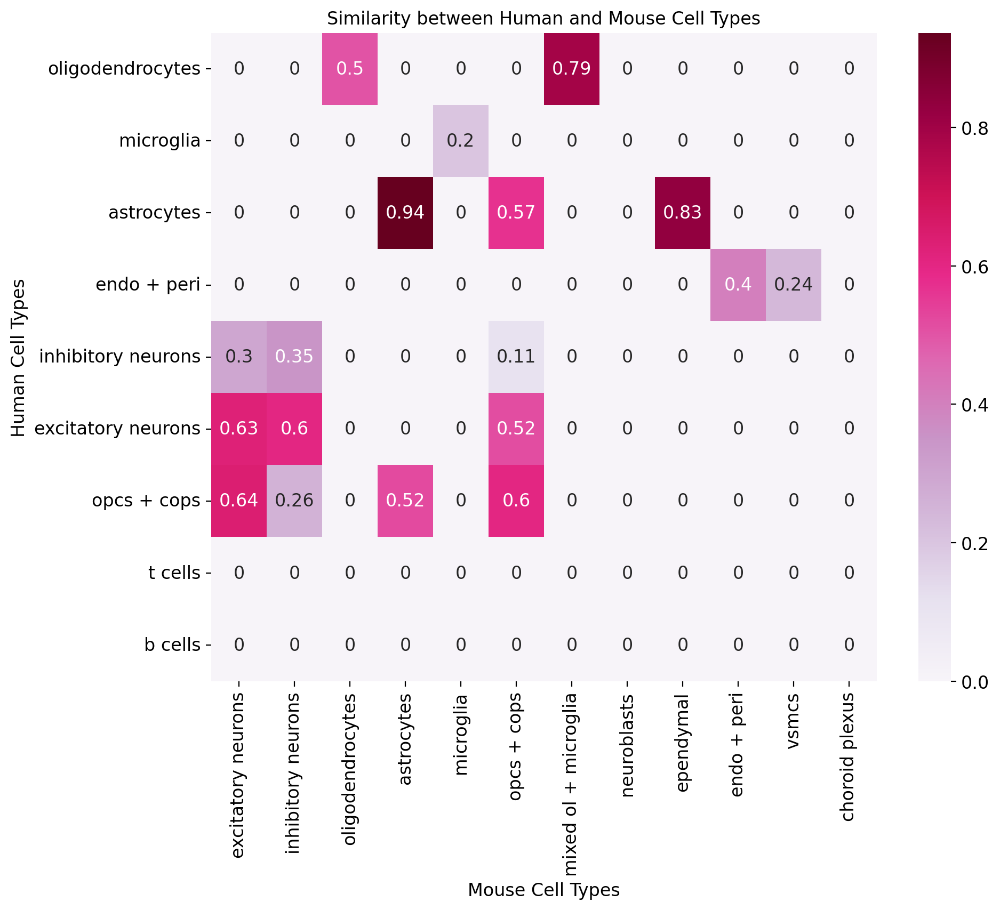

In [57]:
# Create the heatmap
plt.figure(figsize=(10, 8))
ax = sb.heatmap(similarity_matrix, annot=True, cmap='PuRd', cbar=True, linewidths=0)  # Set linewidths to 0 to remove grid lines

# Turns off grid on the left Axis.
ax.grid(False)

# Set the title and labels
plt.title('Similarity between Human and Mouse Cell Types')
plt.xlabel('Mouse Cell Types')
plt.ylabel('Human Cell Types')

# Show the plot
plt.show()

In [84]:
adata_all = sc.read('./sysVI_h2m_NEW_allgenes.h5ad')

# Some QC calcs

In [ ]:
adata_all2=adata_all.copy()

In [68]:
adata_all.var["mt"] = adata_all.var_names.str.startswith("MT-")
adata_all.var["hb"] = adata_all.var_names.str.contains(("^HB[^(P)]"))
adata_all.var["ribo"] = adata_all.var_names.str.startswith(("RPS", "RPL"))

In [69]:
sc.pp.calculate_qc_metrics(
    adata_all, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

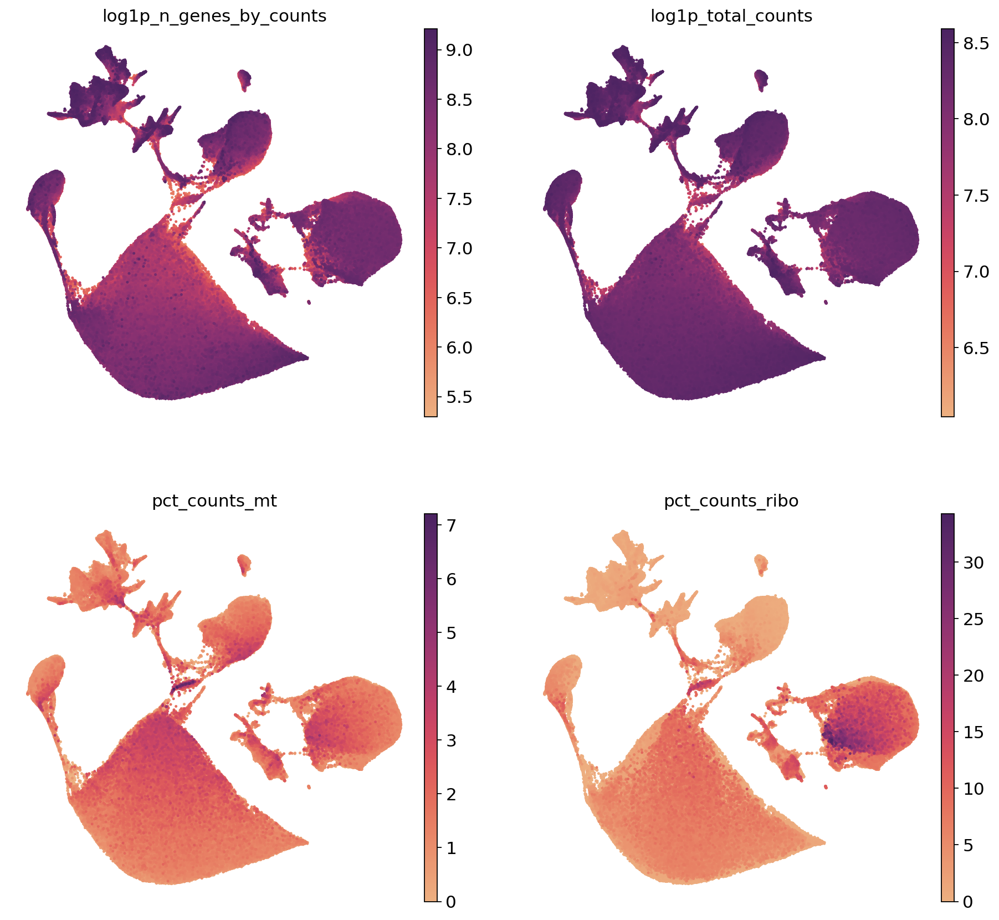

In [27]:
# Set figure parameters for high-resolution display and saving
sc.set_figure_params(dpi_save=300, figsize=(6, 6), transparent=True)

sc.pl.umap(adata_all, color=['log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_mt', 'pct_counts_ribo'],
           cmap='flare',ncols=2, s=20, frameon=False,
          save='_H2M_sysVI_ALL_QC_plots_reduced.pdf')

# Add cell cycle analysis

In [28]:
cell_cycle_genes = [x.strip() for x in open('/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/regev_lab_cell_cycle_genes.txt')]

In [29]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

In [30]:
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_all.var_names]

In [32]:
sc.tl.score_genes_cell_cycle(adata_all, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    600 total control genes are used. (0:00:11)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    601 total control genes are used. (0:00:10)
-->     'phase', cell cycle phase (adata.obs)


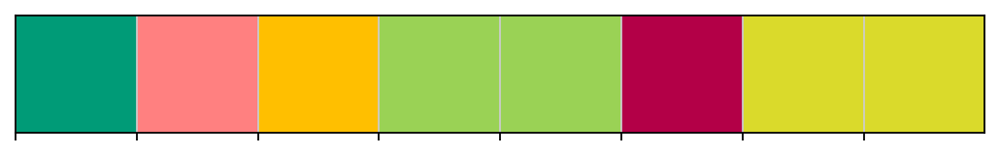

In [33]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]
sb.palplot(pair2)

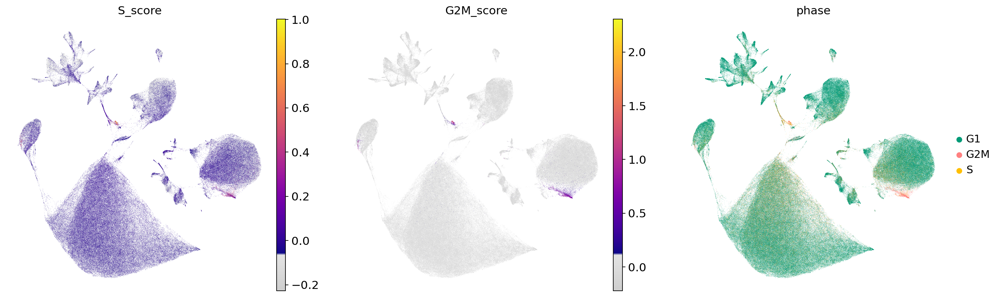

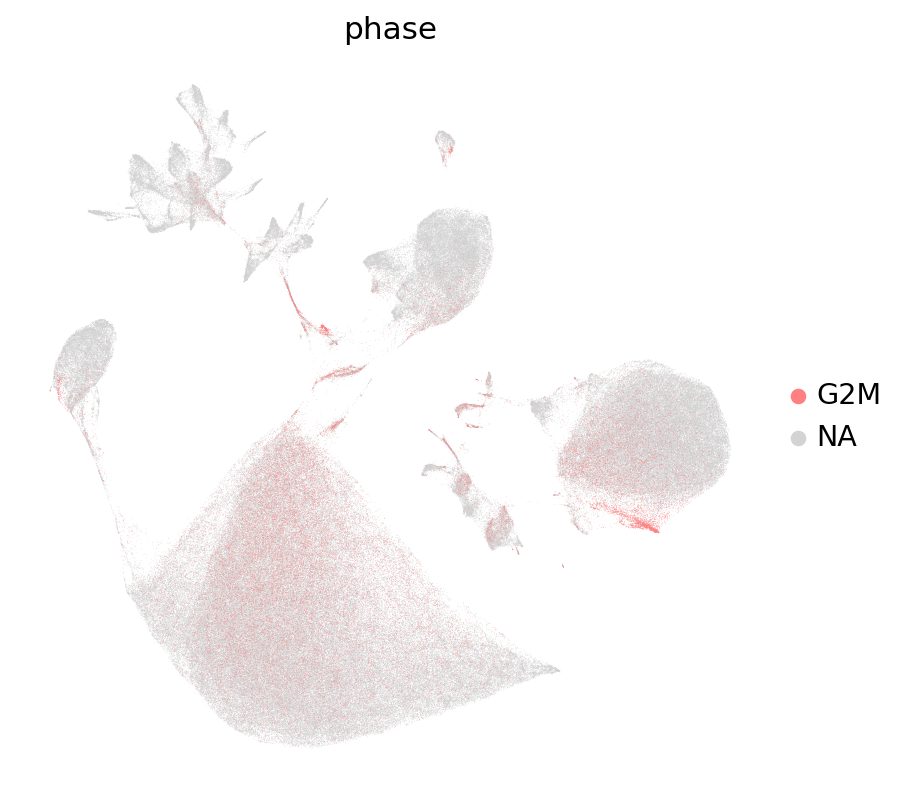

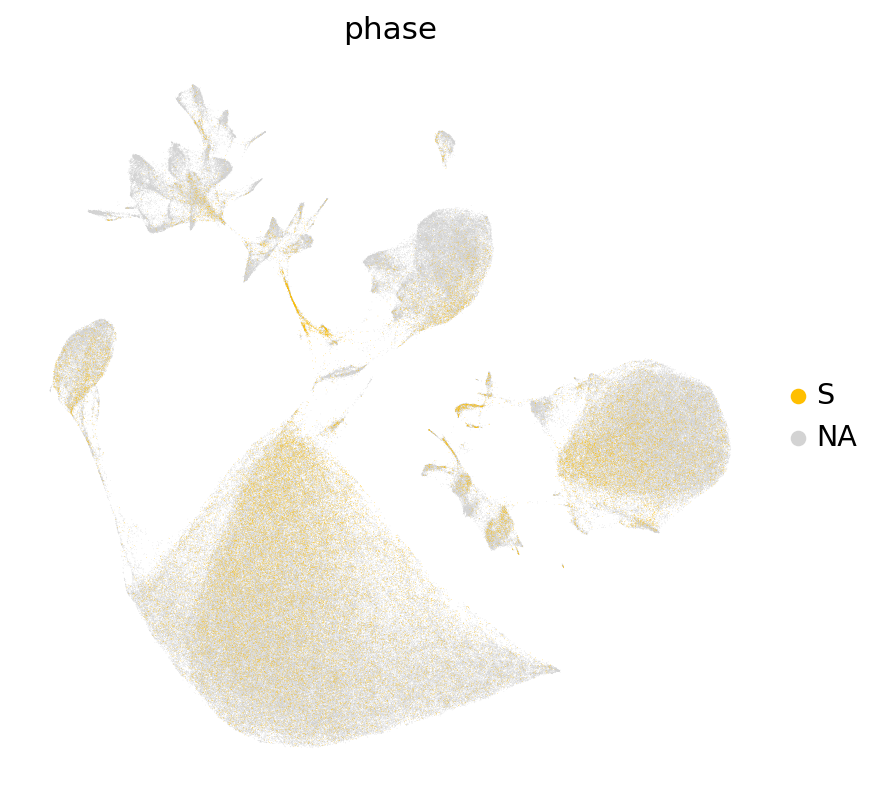

In [34]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.umap(adata_all, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, cmap=mymap2)
sc.pl.umap(adata_all, color='phase',groups=['G2M'],  palette=pair2, use_raw=False, frameon=False)
sc.pl.umap(adata_all, color='phase',groups=['S'],  palette=pair2, use_raw=False, frameon=False)

In [35]:
sc.tl.score_genes(adata_all, list(cell_cycle_genes), score_name='Cycling cells' )

computing score 'Cycling cells'
    finished: added
    'Cycling cells', score of gene set (adata.obs).
    695 total control genes are used. (0:00:10)


In [36]:
sc.tl.score_genes(adata_all, list(s_genes), score_name='S phase' )

computing score 'S phase'
    finished: added
    'S phase', score of gene set (adata.obs).
    697 total control genes are used. (0:00:10)


In [37]:
Ccc = adata_all.obs['Cycling cells'] >0

In [38]:
adata_all.obs['Cycling_cells'] = Ccc
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].astype('category')

In [39]:
cluster2annotation = {
    False : 'resting',
    True : 'cycling',
 }

In [40]:
adata_all.obs['Cycling_cells'] = adata_all.obs['Cycling_cells'].map(cluster2annotation).astype('category')

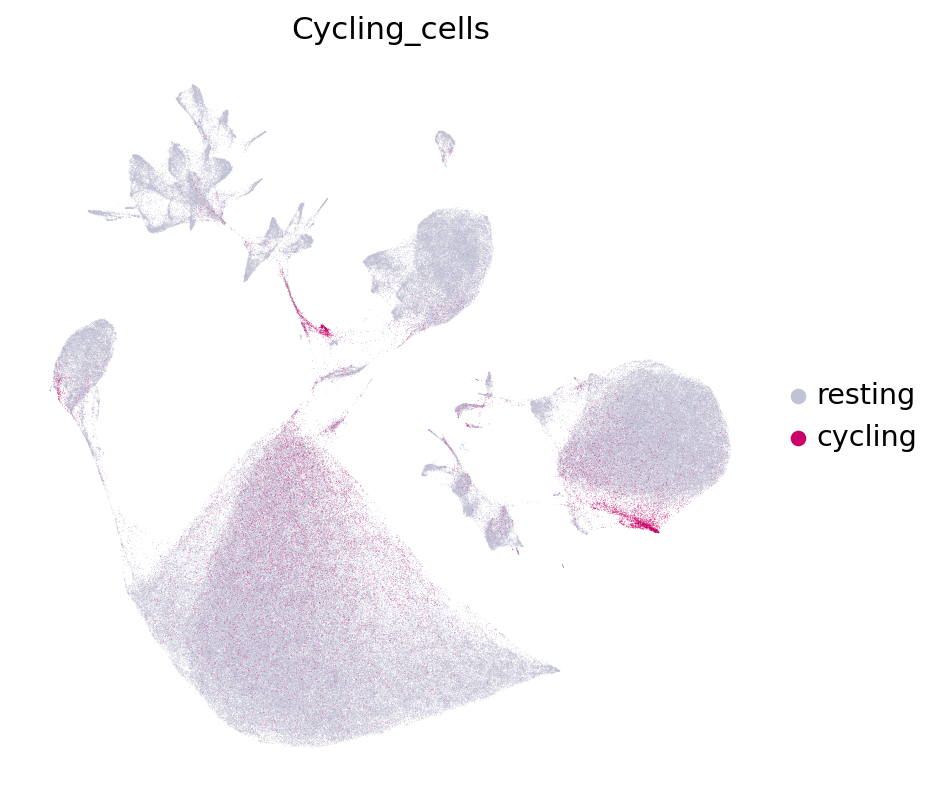

In [41]:
sc.pl.umap(adata_all, color=['Cycling_cells'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [42]:
scells = adata_all.obs['S phase'] >0.05

In [43]:
adata_all.obs['S_phase_cells'] = scells
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].astype('category')

In [44]:
cluster2annotation = {
    False : 'NA',
    True : 'S phase',
 }

In [45]:
adata_all.obs['S_phase_cells'] = adata_all.obs['S_phase_cells'].map(cluster2annotation).astype('category')

In [70]:
adata_annotated_genes.to_csv('./h2m_adata_all_leiden1_rank_genes.csv')

In [73]:
adata_all.write_h5ad('./h2m_all_TEMP.h5ad')

# Complete cluster naming and plotting

In [47]:
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

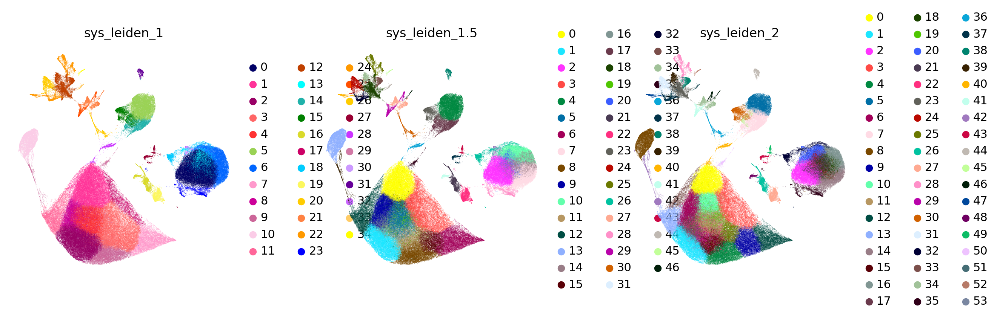

In [8]:
sc.pl.umap(adata_all, color=['sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2'], frameon=False)

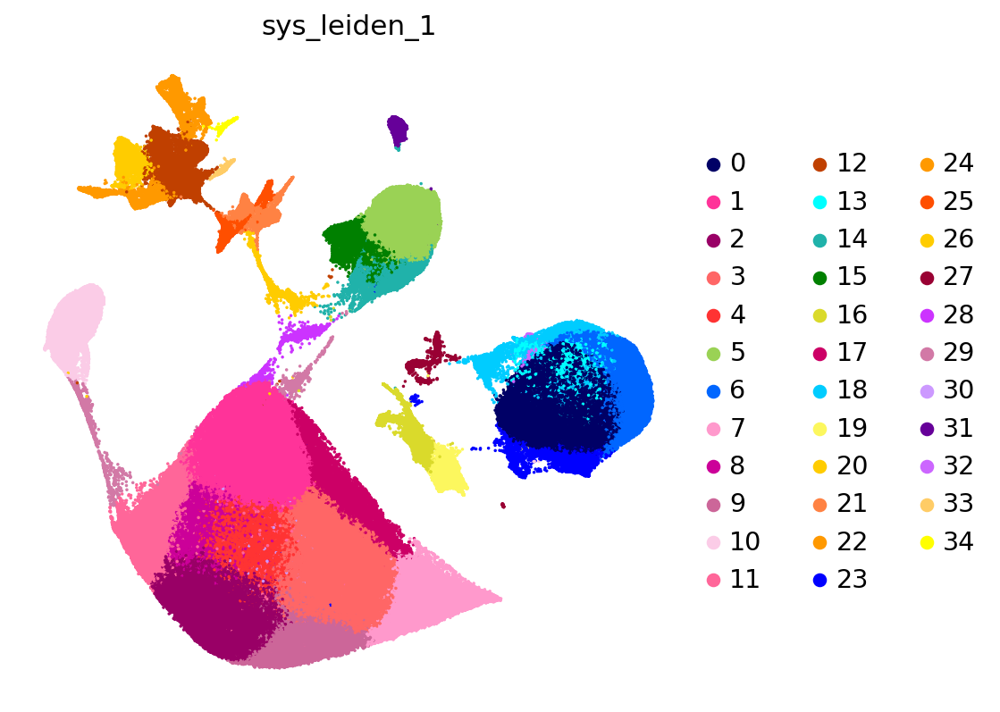

In [77]:
sc.pl.umap(adata_all, color=['sys_leiden_1'], frameon=False, s=10)

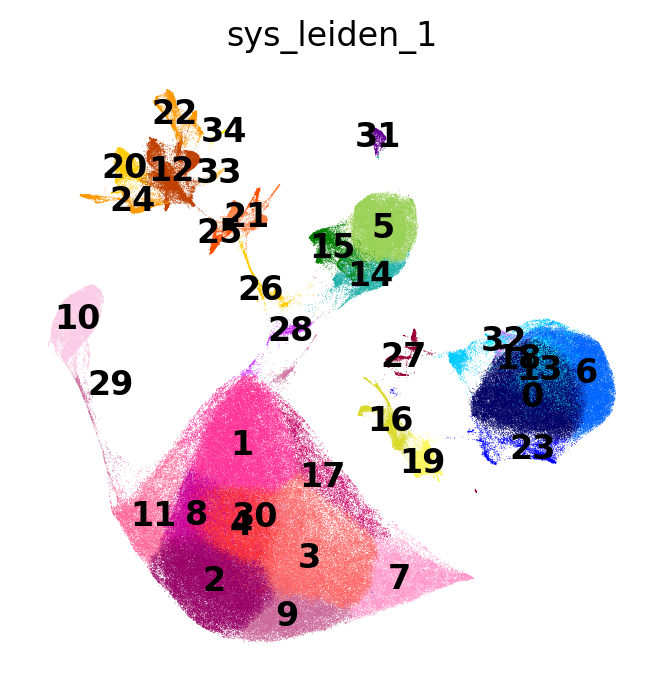

In [12]:
sc.pl.umap(adata_all, color=['sys_leiden_1'], frameon=False, legend_loc='on data')

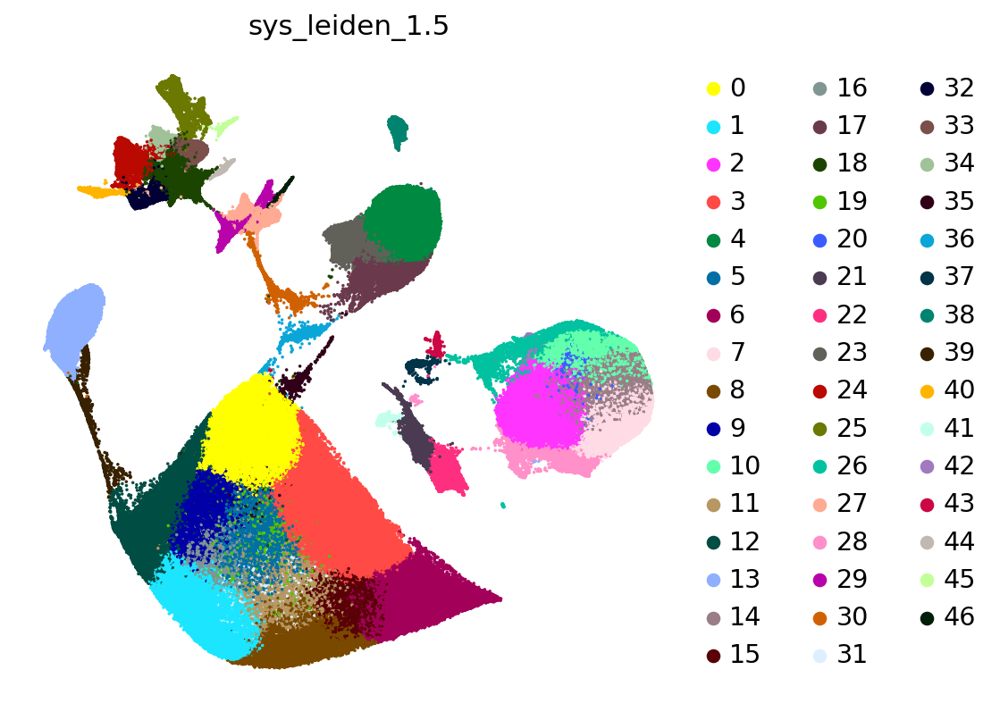

In [76]:
sc.pl.umap(adata_all, color=['sys_leiden_1.5'], frameon=False, s=10)

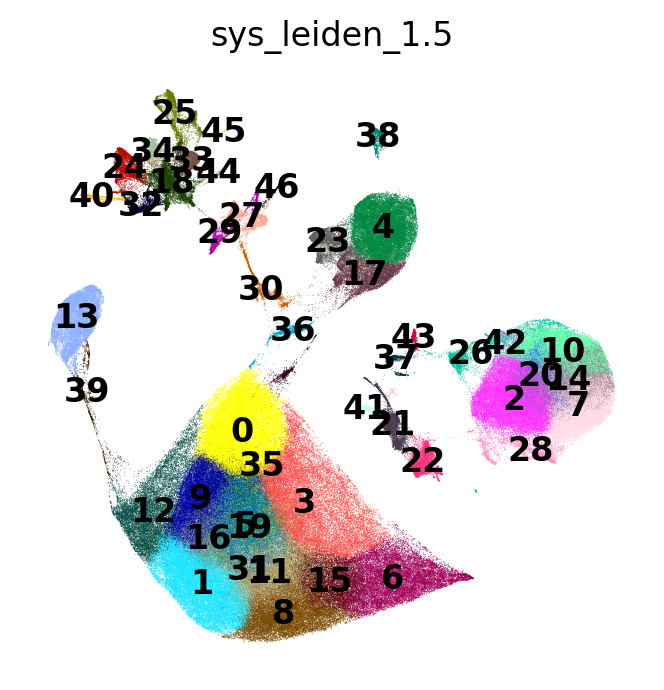

In [11]:
sc.pl.umap(adata_all, color=['sys_leiden_1.5'], frameon=False, legend_loc='on data')

In [47]:
cluster_1_annotation = {
    '0': 'Microglia',
    '1': 'MOLs',
    '2': 'MOLs',
    '3': 'MOLs',
    '4': 'MOLs',
    '5': 'Astrocytes',
    '6': 'Microglia',
    '7': 'MOLs',
    '8': 'MOLs',
    '9': 'MOLs',
    '10': 'OPCs',
    '11': 'MOLs',
    '12': 'Neurons',
    '13': 'Microglia',
    '14': 'Astrocytes',
    '15': 'Astrocytes',
    '16': 'Pericytes',
    '17': 'MOLs',
    '18': 'Microglia',
    '19': 'Endothelial cells',
    '20': 'Neurons',
    '21': 'Neurons',
    '22': 'Neurons',
    '23': 'Microglia/MOL mixed',
    '24': 'Neurons',
    '25': 'Neurons',
    '26': 'NPCs',
    '27': 'T/B cells',
    '28': 'Choroid plexus',
    '29': 'COPs',
    '30': 'MOLs',
    '31': 'Ependymal cells',
    '32': 'BAMs',
    '33': 'Neurons',
    '34': 'Neurons'
}

In [48]:
adata_all.obs['cluster_annotation'] = adata_all.obs['sys_leiden_1'].map(cluster_1_annotation).astype('category')

In [36]:
cluster2annotation = {
    '0': '0_Microglia',
    '1': '1_MOLs',
    '2': '2_MOLs',
    '3': '3_MOLs',
    '4': '4_MOLs',
    '5': '5_Astrocytes',
    '6': '6_Microglia',
    '7': '7_MOLs',
    '8': '8_MOLs',
    '9': '9_MOLs',
    '10': '10_OPCs',
    '11': '11_MOLs',
    '12': '12_Neurons',
    '13': '13_Microglia',
    '14': '14_Astrocytes',
    '15': '15_Astrocytes',
    '16': '16_Pericytes',
    '17': '17_MOLs',
    '18': '18_Microglia',
    '19': '19_Endothelial cells',
    '20': '20_Neurons',
    '21': '21_Neurons',
    '22': '22_Neurons',
    '23': '23_Microglia/MOL mixed',
    '24': '24_Neurons',
    '25': '25_Neurons',
    '26': '26_NPCs',
    '27': '27_T/B cells',
    '28': '28_Choroid plexus',
    '29': '29_COPs',
    '30': '30_MOLs',
    '31': '31_Ependymal cells',
    '32': '32_BAMs',
    '33': '33_Neurons',
    '34': '34_Neurons'  
}

In [37]:
adata_all.obs['cell_leiden_annotated'] = adata_all.obs['sys_leiden_1'].map(cluster2annotation).astype('category')

In [38]:
adata_all.obs['cell_leiden_annotated'].value_counts()

cell_leiden_annotated
0_Microglia               46439
1_MOLs                    45302
2_MOLs                    44937
3_MOLs                    38709
4_MOLs                    26658
5_Astrocytes              24971
6_Microglia               24550
7_MOLs                    16823
8_MOLs                    16724
9_MOLs                    16651
10_OPCs                   15527
11_MOLs                   15214
12_Neurons                12937
13_Microglia               9344
14_Astrocytes              7720
15_Astrocytes              6691
16_Pericytes               6582
17_MOLs                    6446
18_Microglia               6180
19_Endothelial cells       5321
20_Neurons                 4764
21_Neurons                 4431
22_Neurons                 4412
23_Microglia/MOL mixed     4083
24_Neurons                 3823
25_Neurons                 3069
26_NPCs                    2960
27_T/B cells               2899
28_Choroid plexus          2007
29_COPs                    1998
30_MOLs           

In [39]:
adata_all.obs['cluster_annotation'].value_counts()

cluster_annotation
MOLs                   229363
Microglia               86513
Astrocytes              39382
Neurons                 34529
OPCs                    15527
Pericytes                6582
Endothelial cells        5321
Microglia/MOL mixed      4083
NPCs                     2960
T/B cells                2899
Choroid plexus           2007
COPs                     1998
Ependymal cells          1519
BAMs                      900
Name: count, dtype: int64

In [80]:
# Define the order of cell types
cell_type_order = [
    'OPCs', 'COPs', 'MOLs', 'Microglia',
    'Astrocytes', 'Neuroblasts', 'Neurons',
    'Endo + Peri', 'Ependymal', 'Choroid plexus', 'T/B cells']

# Reorder the cell types
adata_all.obs['cluster_annotation'] = pd.Categorical(adata_all.obs['cluster_annotation'], categories=cell_type_order, ordered=True)

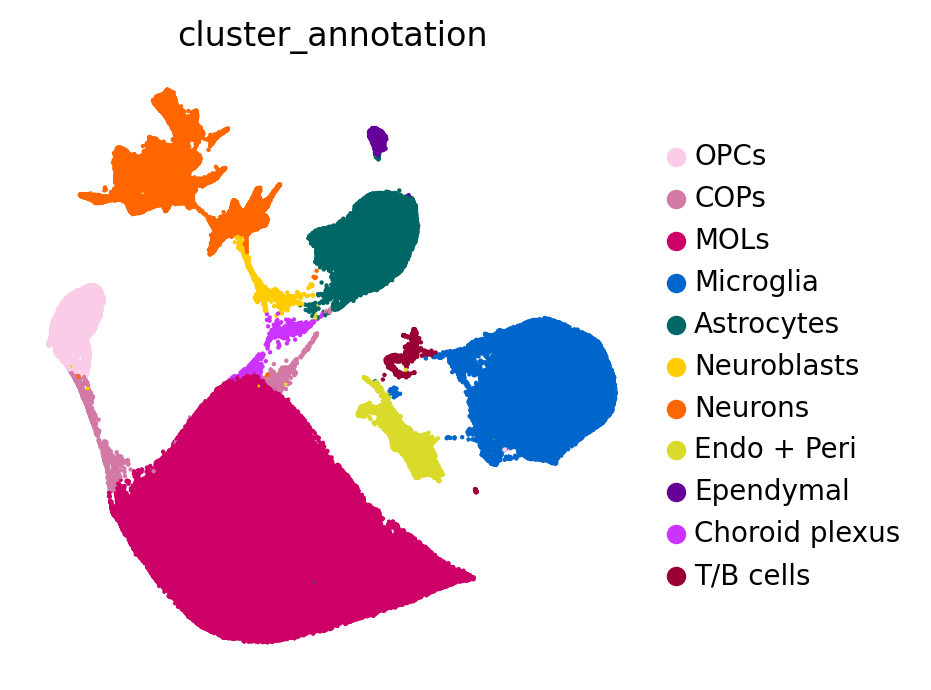

In [81]:
cluster_simplified_color = {
    'Neurons': '#ff6600',
    'COPs': '#d279a6',
    'MOLs': '#cc0066',
    'OPCs': '#fbcce7',
    'Microglia': '#0066cc',
    'Astrocytes': '#006666',
    'Neuroblasts': '#ffcc00',
    'Ependymal': '#660099',
    'Endo + Peri': '#dada2b',
    'T/B cells': '#990033',
    'Choroid plexus': '#cc33ff'
}

today='_July29'

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cluster_annotation'], legend_fontsize =float(10) , 
           wspace=0.6, cmap=mymap2,palette=cluster_simplified_color, s=10,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'_H2M_sysVI_cell_types.pdf' )

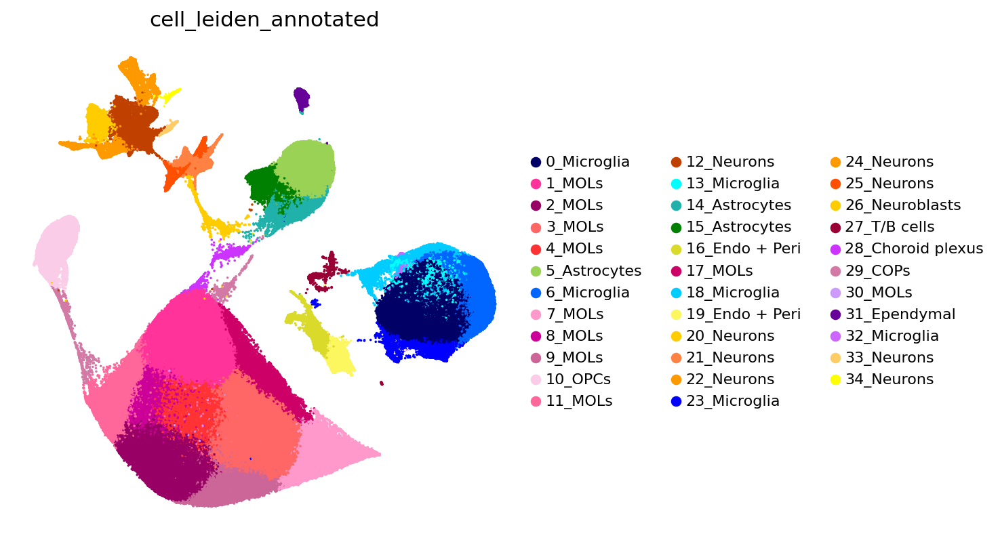

In [159]:
cluster_color = {
    '0_Microglia': '#000066',
    '1_MOLs': '#ff3399',
    '2_MOLs': '#990066',
    '3_MOLs': '#ff6666',
    '4_MOLs': '#ff3333',
    '5_Astrocytes': '#9AD255',
    '6_Microglia': '#0066ff',
    '7_MOLs': '#ff99cc',
    '8_MOLs': '#cc0099',
    '9_MOLs': '#cc6699',
    '10_OPCs': '#fbcce7',
    '11_MOLs': '#ff6699',
    '12_Neurons': '#c04000',
    '13_Microglia': '#00ffff',
    '14_Astrocytes': '#20B2AA',
    '15_Astrocytes': '#008000',
    '16_Endo + Peri': '#dada2b',
    '17_MOLs': '#cc0066',
    '18_Microglia': '#00ccff',
    '19_Endo + Peri': '#fcf75e',
    '20_Neurons': '#ffcc00',
    '21_Neurons': '#ff8243',
    '22_Neurons': '#ff9900',
    '23_Microglia': '#0000ff',
    '24_Neurons': '#ff9900',
    '25_Neurons': '#ff4f00',
    '26_Neuroblasts': '#ffcc00',
    '27_T/B cells': '#990033',
    '28_Choroid plexus': '#cc33ff',
    '29_COPs': '#d279a6',
    '30_MOLs': '#cc99ff',
    '31_Ependymal': '#660099',
    '32_Microglia': '#cc66ff',
    '33_Neurons': '#ffcc66',
    '34_Neurons': '#ffff00'
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['cell_leiden_annotated'], legend_fontsize =float(10) , 
           wspace=0.6, cmap=mymap2,palette=cluster_color, s=10,
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'_H2M_sysVI_leiden_annotated.pdf' )

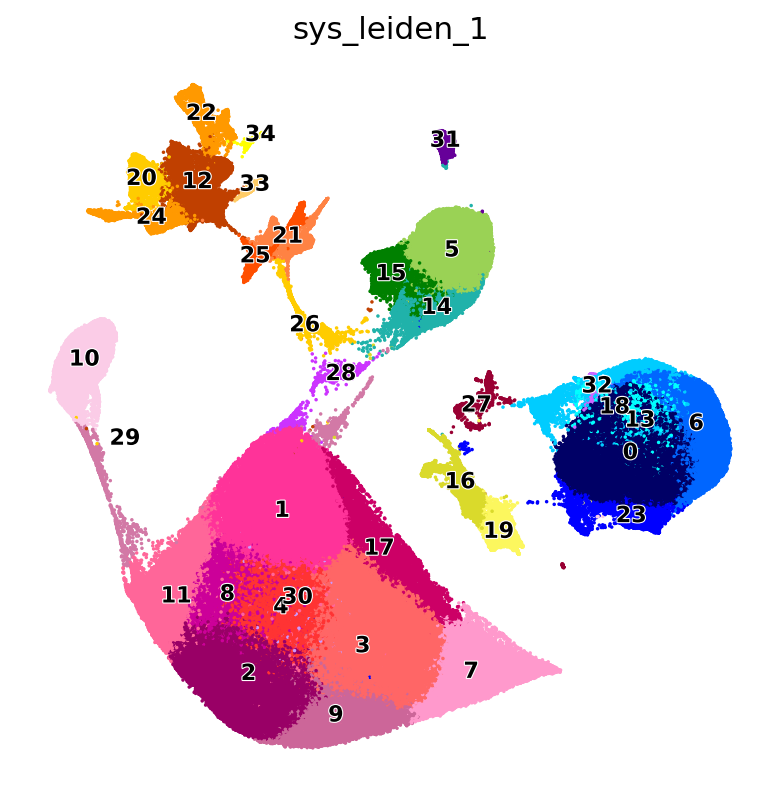

In [108]:
cluster_color = {
    '0': '#000066',
    '1': '#ff3399',
    '2': '#990066',
    '3': '#ff6666',
    '4': '#ff3333',
    '5': '#9AD255',
    '6': '#0066ff',
    '7': '#ff99cc',
    '8': '#cc0099',
    '9': '#cc6699',
    '10': '#fbcce7',
    '11': '#ff6699',
    '12': '#c04000',
    '13': '#00ffff',
    '14': '#20B2AA',
    '15': '#008000',
    '16': '#dada2b',
    '17': '#cc0066',
    '18': '#00ccff',
    '19': '#fcf75e',
    '20': '#ffcc00',
    '21': '#ff8243',
    '22': '#ff9900',
    '23': '#0000ff',
    '24': '#ff9900',
    '25': '#ff4f00',
    '26': '#ffcc00',
    '27': '#990033',
    '28': '#cc33ff',
    '29': '#d279a6',
    '30': '#cc99ff',
    '31': '#660099',
    '32': '#cc66ff',
    '33': '#ffcc66',
    '34': '#ffff00'
}

#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all, color=['sys_leiden_1'], legend_fontsize =float(10) , 
           wspace=0.6, cmap=mymap2,palette=cluster_color, s=10, legend_loc='on data',
           legend_fontweight= 'bold', frameon= False , legend_fontoutline=1, save=today+'_H2M_sysVI_leiden.pdf' )

# Plot cell annotation by publication 

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


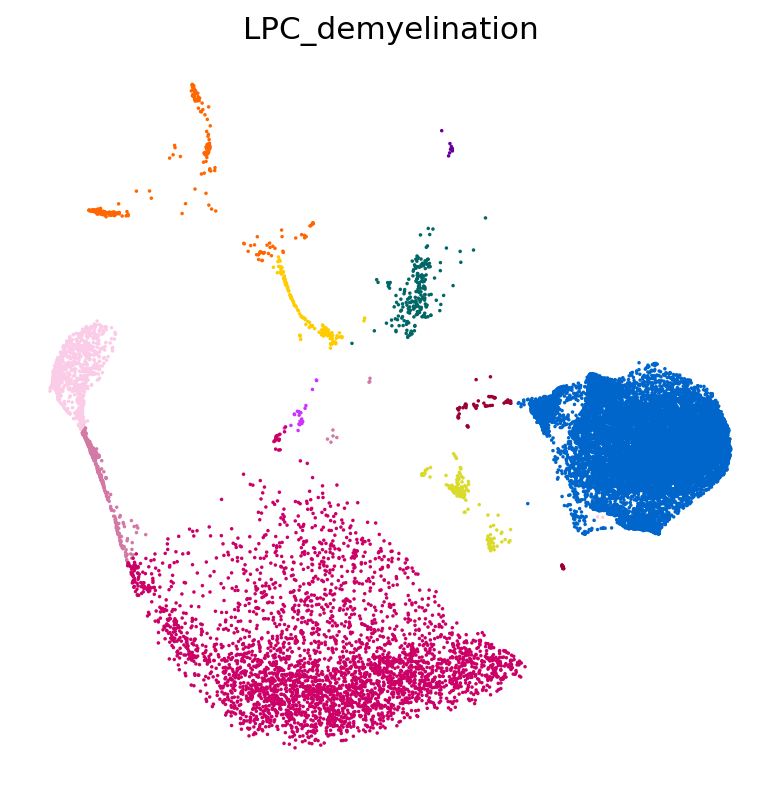

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


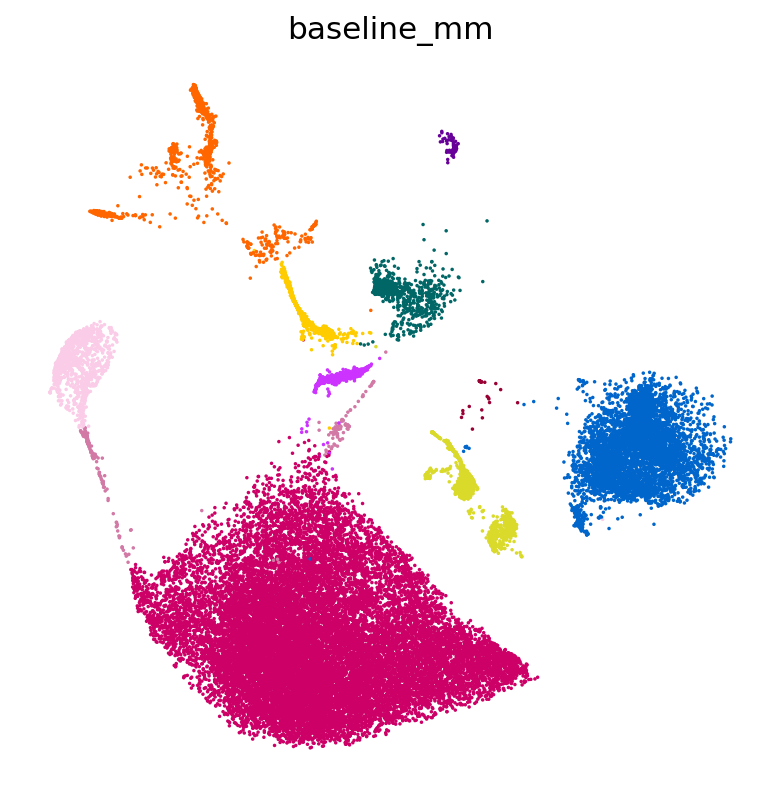

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


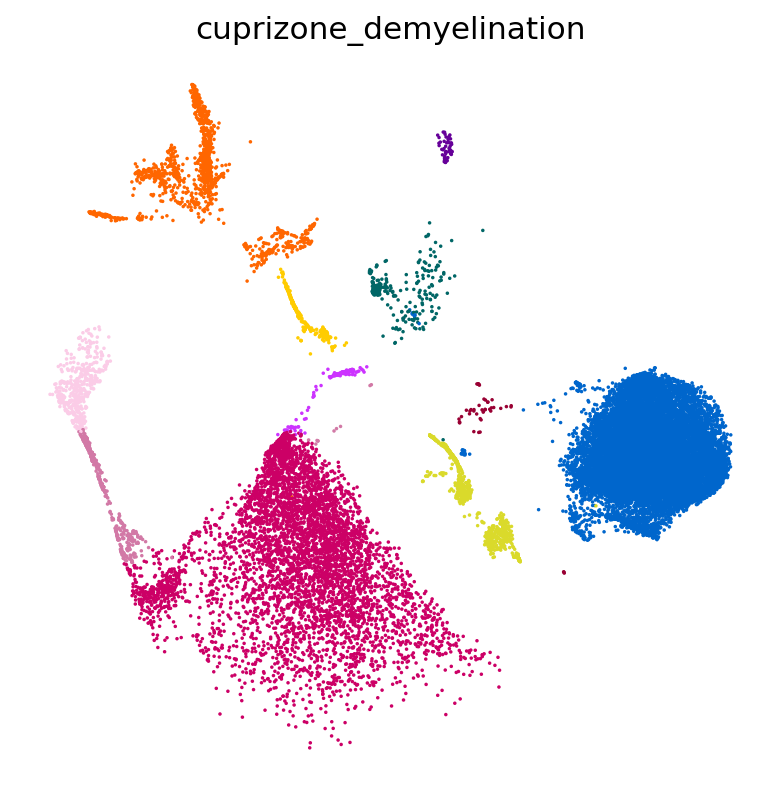

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


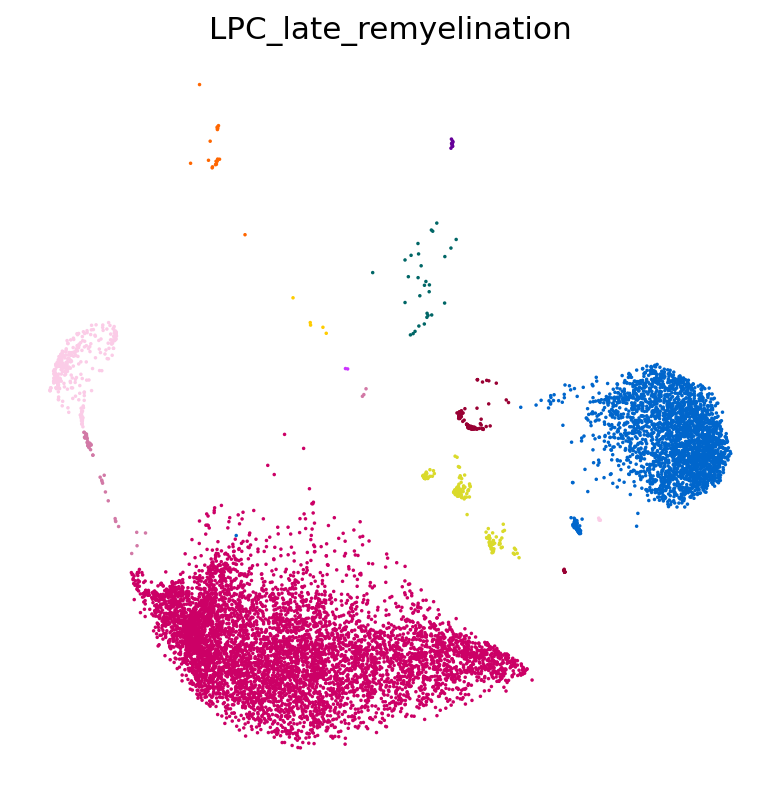

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


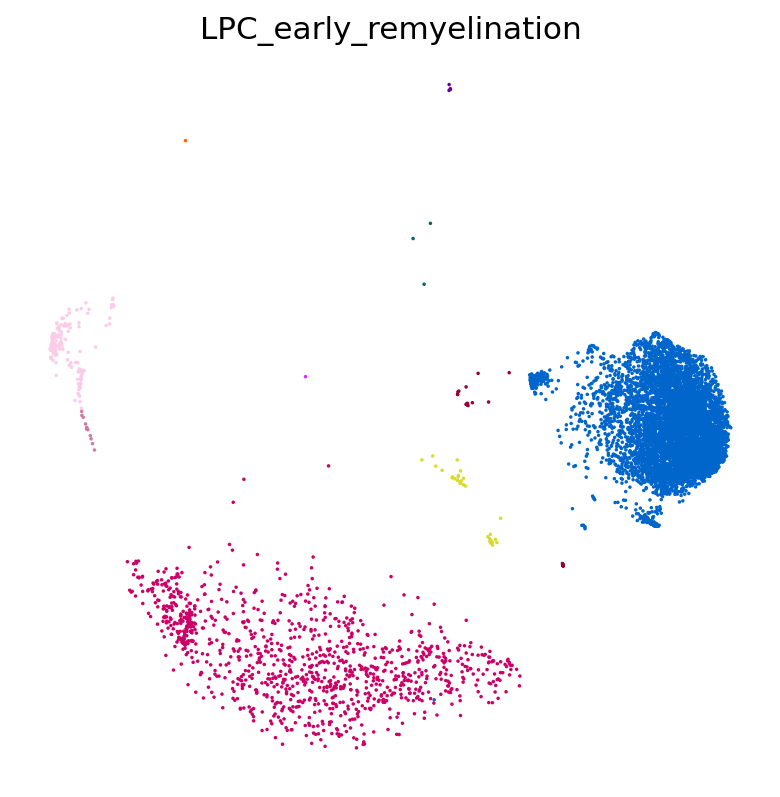

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


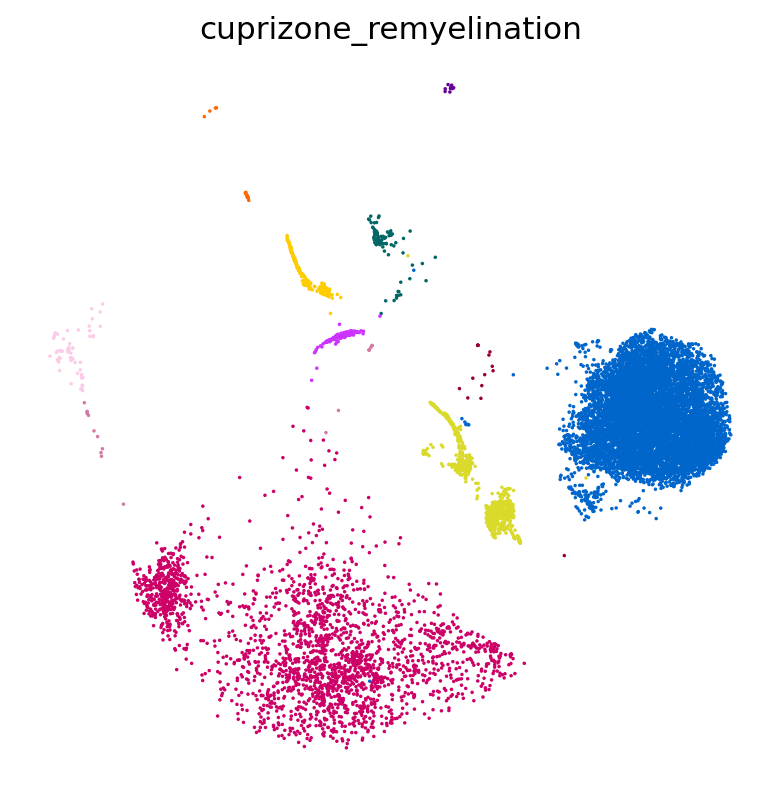

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


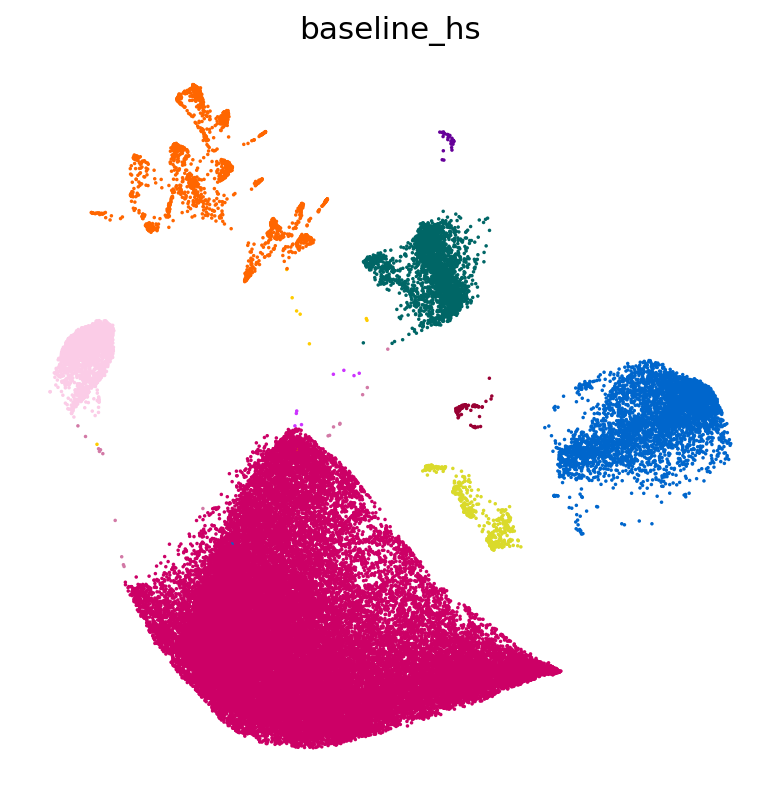

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


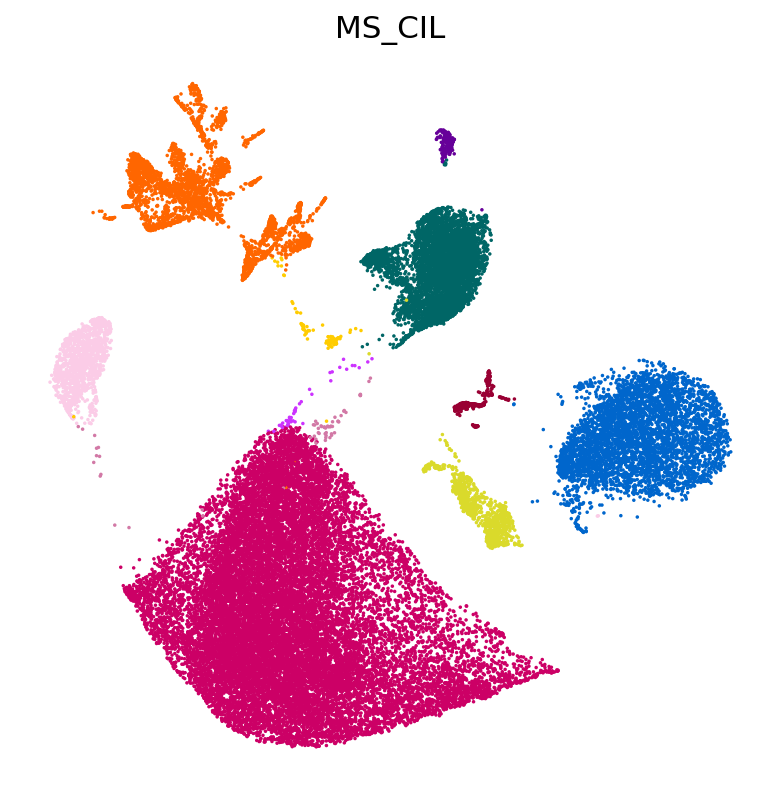

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


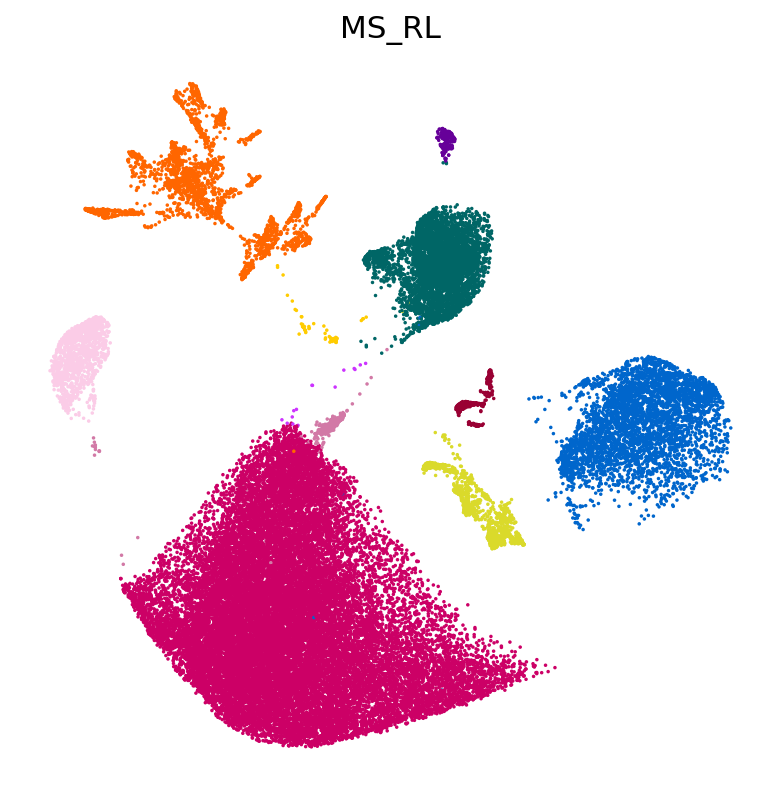

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


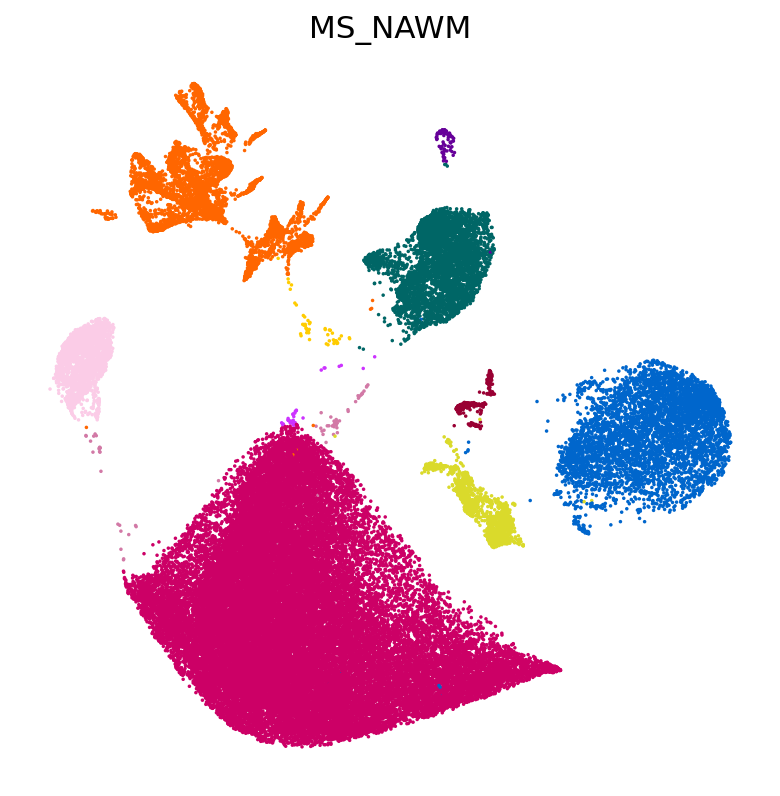

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


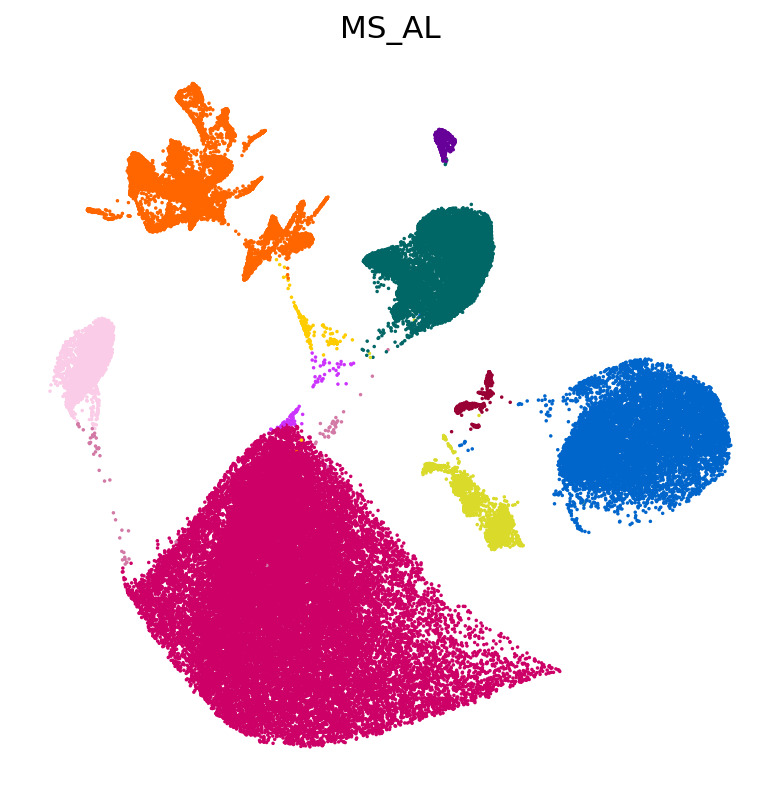

/afs/crc.nd.edu/user/e/eaboelno/miniforge3/envs/edgeR/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


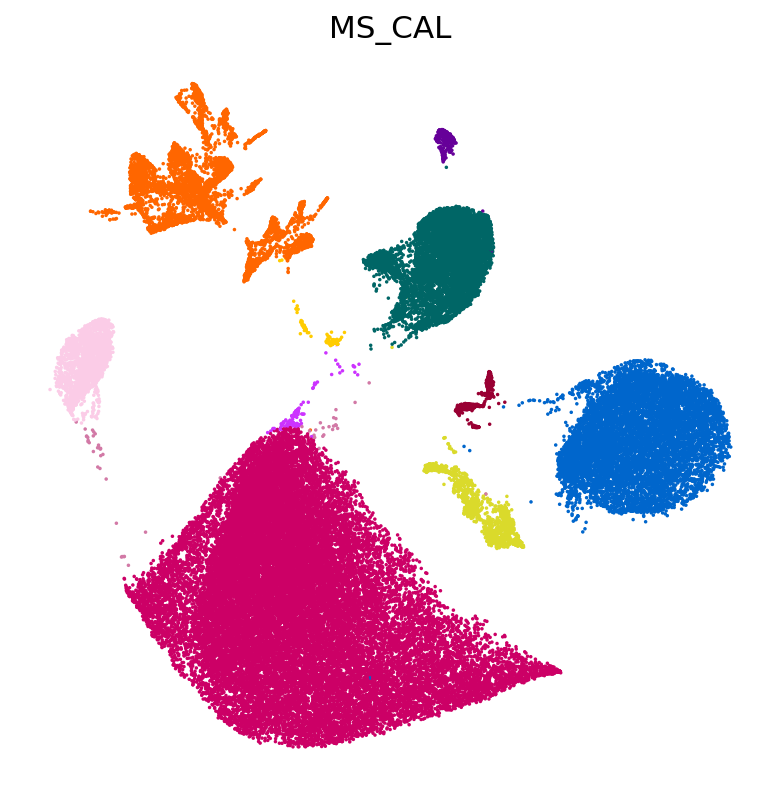

In [124]:
cluster_simplified_color = {
    'Neurons': '#ff6600',
    'COPs': '#d279a6',
    'MOLs': '#cc0066',
    'OPCs': '#fbcce7',
    'Microglia': '#0066cc',
    'Astrocytes': '#006666',
    'Neuroblasts': '#ffcc00',
    'Ependymal': '#660099',
    'EC + Peri': '#dada2b',
    'T/B cells': '#990033',
    'Choroid plexus': '#cc33ff'
}

# Plot each dataset separately
for data in adata_all.obs['lesion_status'].unique():
    subset_data = adata_all[adata_all.obs['lesion_status'] == data, :]
    filename = f"{data}_hs_broad_cell_types_by_diagnosis"  # Unique filename for each plot
    sc.pl.umap(
        subset_data,
        color=["cluster_annotation"],
        cmap=mymap2,
        palette=cluster_simplified_color,  # Use the predefined color mapping
        title=data,
        frameon=False,
        legend_loc=None,
        ncols=1,
        s=10,
        save=filename,  # Save with the unique filename
    )

 # Downsampling

In [13]:
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [113]:
adata_all.obs['lesion_status'].value_counts()

lesion_status
MS_AL                      71049
MS_NAWM                    58176
MS_CAL                     57991
baseline_hs                53729
MS_RL                      42972
MS_CIL                     37649
baseline_mm                35611
cuprizone_demyelination    23672
LPC_demyelination          21398
cuprizone_remyelination    13329
LPC_late_remyelination     10082
LPC_early_remyelination     7925
Name: count, dtype: int64

In [ ]:
MS_AL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_AL'],n_obs=3516,copy=True).obs_names
MS_NAWM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_NAWM'],n_obs=3516,copy=True).obs_names
MS_CAL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CAL'],n_obs=3516,copy=True).obs_names
hs_WM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='baseline_hs'],n_obs=3516,copy=True).obs_names
MS_RL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_RL'],n_obs=3516,copy=True).obs_names
MS_CIL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CIL'],n_obs=3516,copy=True).obs_names

Cuprizone_4w = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_4w'],n_obs=3516,copy=True).obs_names
Normal_chow2 = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Normal_chow2'],n_obs=3516,copy=True).obs_names
LPC_5dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_5dpl'],n_obs=3516,copy=True).obs_names
Cuprizone_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_remyelination'],n_obs=3516,copy=True).obs_names
LPC_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_remyelination'],n_obs=3516,copy=True).obs_names
No_lesion = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='No_lesion'],n_obs=3516,copy=True).obs_names
LPC_14dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_14dpl'],n_obs=3516,copy=True).obs_names
LPC_7dpl = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_7dpl'],n_obs=3516,copy=True).obs_names
Saline = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Saline'],n_obs=3516,copy=True).obs_names
Cuprizone_5w = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Cuprizone_5w'],n_obs=3516,copy=True).obs_names
Normal_chow = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='Normal_chow'],n_obs=3516,copy=True).obs_names

In [116]:
MS_AL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_AL'],n_obs=7925,copy=True).obs_names
MS_NAWM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_NAWM'],n_obs=7925,copy=True).obs_names
MS_CAL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CAL'],n_obs=7925,copy=True).obs_names
hs_WM = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='baseline_hs'],n_obs=7925,copy=True).obs_names
MS_RL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_RL'],n_obs=7925,copy=True).obs_names
MS_CIL = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='MS_CIL'],n_obs=7925,copy=True).obs_names

baseline_mm = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='baseline_mm'],n_obs=7925,copy=True).obs_names
cuprizone_demyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='cuprizone_demyelination'],n_obs=7925,copy=True).obs_names
LPC_demyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_demyelination'],n_obs=7925,copy=True).obs_names
cuprizone_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='cuprizone_remyelination'],n_obs=7925,copy=True).obs_names
LPC_late_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_late_remyelination'],n_obs=7925,copy=True).obs_names
LPC_early_remyelination = sc.pp.subsample(adata_all[adata_all.obs['lesion_status']=='LPC_early_remyelination'],n_obs=7925,copy=True).obs_names

In [117]:
adata_all_subsample = adata_all[list(baseline_mm) + list(cuprizone_demyelination) + list(LPC_demyelination) +
                                list(cuprizone_remyelination) + list(LPC_late_remyelination) + list(LPC_early_remyelination) +
                                list(hs_WM) + list(MS_AL) + list(MS_NAWM) + list(MS_CAL) + list(MS_RL) +
                                list(MS_CIL) ].copy()
adata_all_subsample

AnnData object with n_obs × n_vars = 95100 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_r

In [118]:
adata_all_subsample.obs['lesion_status'].value_counts()

lesion_status
LPC_demyelination          7925
LPC_early_remyelination    7925
LPC_late_remyelination     7925
MS_AL                      7925
MS_CAL                     7925
MS_CIL                     7925
MS_NAWM                    7925
MS_RL                      7925
baseline_hs                7925
baseline_mm                7925
cuprizone_demyelination    7925
cuprizone_remyelination    7925
Name: count, dtype: int64

In [119]:
sc.tl.embedding_density(adata_all_subsample, basis='umap', groupby='lesion_status')

computing density on 'umap'
--> added
    'umap_density_lesion_status', densities (adata.obs)
    'umap_density_lesion_status_params', parameter (adata.uns)


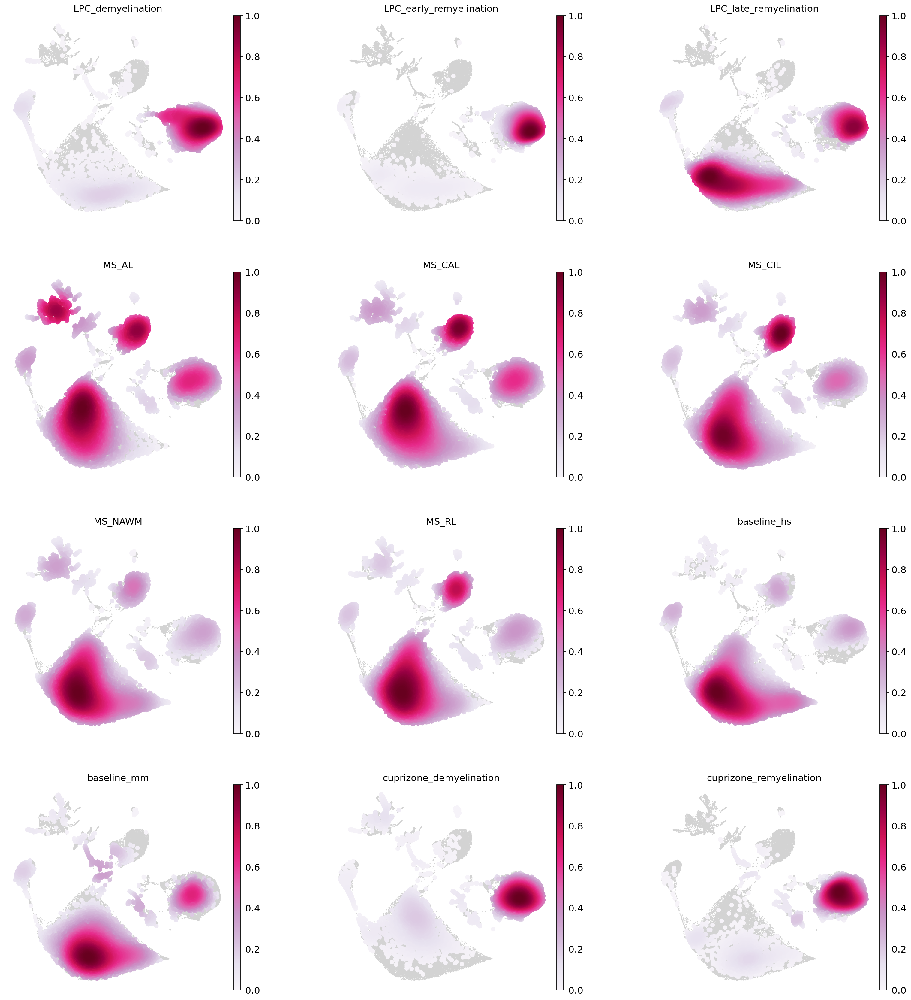

In [120]:
sc.pl.embedding_density(adata_all_subsample, basis='umap',  key='umap_density_lesion_status', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, 
                        ncols=3, save='_distribution_downscaling_all.pdf')

In [ ]:
sc.pl.umap(adata_all_subsample,color='lesion_status',palette=con_cl, legend_fontweight= 'normal', frameon= False ,)

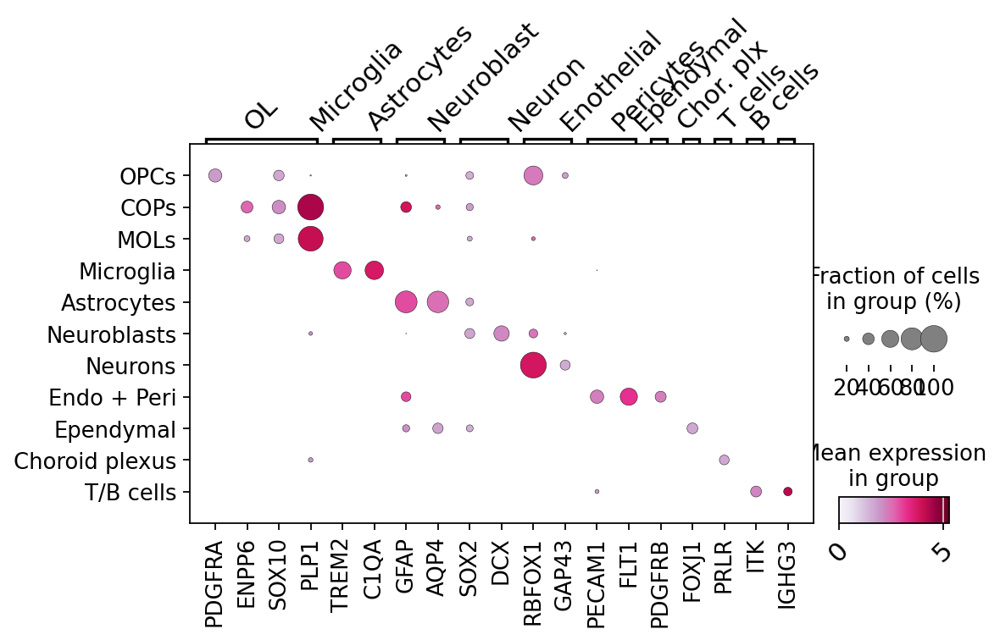

In [160]:
marker_genes = {
    'OL': ['PDGFRA', 'ENPP6', 'SOX10', 'PLP1'],
    'Microglia': ['TREM2', 'C1QA'],
    'Astrocytes': ['GFAP', 'AQP4'],
    'Neuroblast': ['SOX2', 'DCX'],
    'Neuron': ['RBFOX1', 'GAP43'],
    'Enothelial': ['PECAM1','FLT1'],
    'Pericytes': ['PDGFRB'],
    'Ependymal': ['FOXJ1'],
    'Chor. plx': ['PRLR'],
    'T cells':['ITK'],
    'B cells': ['IGHG3']
}

# Flatten the list of genes in marker_genes while maintaining order
all_genes = [gene for genes in marker_genes.values() for gene in genes]

# Correct var_group_positions based on marker_genes
var_group_positions = []
start = 0
for genes in marker_genes.values():
    end = start + len(genes) - 1  # Calculate the end index for the group
    var_group_positions.append((start, end))  # Add the start and end index to var_group_positions
    start = end + 1  # Update the start index for the next group

# Plot the dotplot with the corrected parameters
ax = sc.pl.dotplot(
        adata_all,
        groupby="cluster_annotation",
        var_names=all_genes,
        use_raw=False,
        log=False,
        dendrogram=False,
        layer='log1p_norm',
        var_group_positions=var_group_positions,
        var_group_labels=list(marker_genes.keys()),
        var_group_rotation=45,
        swap_axes=False,  # Keep genes on the x-axis and cell types on the y-axis
        cmap='PuRd',  # Choose a color map for dot intensities
        color_map='PuRd',  # Choose a color map for dot colors
        figsize=(10, 8),  # Set the figure size
        show=False,
        dot_min=0.1,
        mean_only_expressed=True,
        expression_cutoff=1,
    )

# Get the current Axes instance
ax = plt.gca()

# Set the font size and rotation angle for the x-axis (gene labels)
plt.setp(ax.get_xticklabels(), fontsize=14, rotation=45)

# Set the font size for the y-axis (cell type labels)
ax.set_ylabel(ax.get_ylabel(), fontsize=16)

# Set the font size for the x-axis (gene labels)
ax.set_xlabel(ax.get_xlabel(), fontsize=16)

# Adjust spacing between y-axis ticks
plt.subplots_adjust(left=0.4)  # Adjust left margin to reduce space between y-axis ticks and the plot
#plt.subplots_adjust(bottom=0.5) 
plt.subplots_adjust(top=0.5) 

# Save the plot as a PNG file
plt.savefig('./figures/Human_dotplot_all_celltypes_markers.pdf', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

In [141]:
import os

# Print the current working directory
print(os.getcwd())

/afs/crc.nd.edu/user/e/eaboelno/sysVI_analysis/H2M_sysVI_cell_type_refined

# Add a barchart

In [14]:
# Unique values in the 'condition' column
unique_conditions = adata_all.obs['lesion_status_reduced'].unique()
for condition in unique_conditions:
    print(condition)

LPC_demyel

WM_mm

Cupr_demyel

LPC_remyel

LPC_early_remyel

Cupr_remyel

WM_hs

CIL

RL

NAWM

AL

CAL

In [149]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    'LPC_demyelination': 'LPC_demyelination',
    'baseline_mm': 'baseline (mouse)',
    'cuprizone_demyelination': 'cuprizone_demyel',
    'LPC_late_remyelination': 'LPC_late_remyelination',
    'LPC_early_remyelination': 'LPC_early_remyelination',
    'cuprizone_remyelination': 'cuprizone_remyel',
    'baseline_hs': 'WM',
    'MS_CIL': 'CIL',
    'MS_RL': 'RL',
    'MS_NAWM': 'NAWM',
    'MS_AL': 'AL',
    'MS_CAL': 'CAL',
}

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['lesion_renamed'] = adata_all.obs['lesion_status'].map(treatment_map)

In [161]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata_all.obs.groupby(['lesion_renamed', 'cluster_annotation']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='cluster_annotation', columns='lesion_renamed', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/ipykernel_3820321/89056859.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_all.obs.groupby(['lesion_renamed', 'cluster_annotation']).size().reset_index(name='cell_count')


cluster_annotation,OPCs,COPs,MOLs,Microglia,Astrocytes,Neuroblasts,Neurons,Endo + Peri,Ependymal,Choroid plexus,T/B cells
lesion_renamed,,,,,,,,,,,
LPC_demyelination,4.434994,1.761847,17.048322,72.002056,1.018787,0.719693,1.602954,0.775773,0.065427,0.098140,0.472007
LPC_early_remyelination,1.892744,0.151420,13.817035,83.242902,0.037855,0.000000,0.012618,0.365931,0.050473,0.012618,0.416404
LPC_late_remyelination,3.104543,0.505852,64.590359,27.811942,0.297560,0.049593,0.198373,1.596905,0.099187,0.019837,1.725848
AL,4.447635,0.106968,44.826810,14.360512,14.453405,0.405354,17.161396,2.541908,0.624921,0.188602,0.882490
CAL,3.376386,0.096567,51.990826,15.926609,14.328085,0.374196,9.567002,2.391750,0.688038,0.200031,1.060509
CIL,3.251082,0.175303,54.559218,12.005631,15.973864,0.385136,8.927196,2.961566,0.440915,0.119525,1.200563
NAWM,4.190732,0.122043,65.374037,8.922924,8.133938,0.087665,9.522827,2.939356,0.130638,0.053287,0.522552
RL,3.029880,1.396258,62.110211,9.983245,12.710602,0.160570,6.376245,2.738993,0.484036,0.034906,0.975054
WM,4.543170,0.037224,76.413110,8.637793,5.566826,0.014890,3.785665,0.770534,0.061419,0.016751,0.152618


In [15]:
# Group by 'treatment_meta' and 'cell_type_eval' to count cells
cell_type_counts = adata_all.obs.groupby(['lesion_status_reduced', 'cluster_annotation']).size().reset_index(name='cell_count')

# Pivot the DataFrame to have treatments as index and cell types as columns
pivoted_counts = cell_type_counts.pivot(index='cluster_annotation', columns='lesion_status_reduced', values='cell_count').fillna(0)

#Add totals
total_cells = pivoted_counts.sum()

#Add percent
percent_counts = pivoted_counts.div(total_cells) * 100
percent_counts_transposed = percent_counts.transpose()
percent_counts_transposed

/tmp/ipykernel_2804864/1507289107.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = adata_all.obs.groupby(['lesion_status_reduced', 'cluster_annotation']).size().reset_index(name='cell_count')


cluster_annotation,OPCs,COPs,MOLs,Microglia,Astrocytes,Neuroblasts,Neurons,EC + Peri,Ependymal,Choroid plexus,T/B cells
lesion_status_reduced,,,,,,,,,,,
LPC_demyel,4.434994,1.761847,17.048322,72.002056,1.018787,0.719693,1.602954,0.775773,0.065427,0.098140,0.472007
LPC_early_remyel,1.892744,0.151420,13.817035,83.242902,0.037855,0.000000,0.012618,0.365931,0.050473,0.012618,0.416404
LPC_remyel,3.104543,0.505852,64.590359,27.811942,0.297560,0.049593,0.198373,1.596905,0.099187,0.019837,1.725848
AL,4.447635,0.106968,44.826810,14.360512,14.453405,0.405354,17.161396,2.541908,0.624921,0.188602,0.882490
CAL,3.376386,0.096567,51.990826,15.926609,14.328085,0.374196,9.567002,2.391750,0.688038,0.200031,1.060509
CIL,3.251082,0.175303,54.559218,12.005631,15.973864,0.385136,8.927196,2.961566,0.440915,0.119525,1.200563
NAWM,4.190732,0.122043,65.374037,8.922924,8.133938,0.087665,9.522827,2.939356,0.130638,0.053287,0.522552
RL,3.029880,1.396258,62.110211,9.983245,12.710602,0.160570,6.376245,2.738993,0.484036,0.034906,0.975054
WM_hs,4.543170,0.037224,76.413110,8.637793,5.566826,0.014890,3.785665,0.770534,0.061419,0.016751,0.152618


In [22]:
# Define the desired order of treatments and cell types
desired_treatments_order = ['WM_hs', 'NAWM', 'AL', 
                            'CAL', 'CIL', 'RL', 'WM_mm', 'LPC_demyel',
                           'LPC_early_remyel', 'LPC_remyel', 'Cupr_demyel', 'Cupr_remyel']

desired_cell_types_order = ['OPCs', 'COPs', 'MOLs', 'Microglia', 'Astrocytes', 'Neuroblasts', 'Neurons',
                            'EC + Peri', 'Ependymal', 'Choroid plexus', 'T/B cells']

# Reorder the columns and the index of the percent_counts DataFrame
percent_counts_reordered = percent_counts_transposed[desired_cell_types_order].reindex(desired_treatments_order)

# Sum the counts of the specified cell types to create the 'other' category
percent_counts_reordered['Other'] = percent_counts_reordered[['Neuroblasts',
                            'EC + Peri', 'Ependymal', 'Choroid plexus']].sum(axis=1)

# Remove the individual cell type columns from the DataFrame
percent_counts_reordered.drop(columns=['Neuroblasts',
                            'EC + Peri', 'Ependymal', 'Choroid plexus',], inplace=True)

# Reorder the columns of the DataFrame with the 'other' category included
desired_cell_types_order_updated = ['OPCs', 'COPs', 'MOLs', 'Microglia', 'Astrocytes', 'Neurons','T/B cells', 'Other']
percent_counts_reordered = percent_counts_reordered[desired_cell_types_order_updated]
percent_counts_reordered = percent_counts_reordered.drop(index='LPC_early_remyel')

percent_counts_reordered

cluster_annotation,OPCs,COPs,MOLs,Microglia,Astrocytes,Neurons,T/B cells,Other
lesion_status_reduced,,,,,,,,
WM_hs,4.543170,0.037224,76.413110,8.637793,5.566826,3.785665,0.152618,0.863593
NAWM,4.190732,0.122043,65.374037,8.922924,8.133938,9.522827,0.522552,3.210946
AL,4.447635,0.106968,44.826810,14.360512,14.453405,17.161396,0.882490,3.760785
CAL,3.376386,0.096567,51.990826,15.926609,14.328085,9.567002,1.060509,3.654015
CIL,3.251082,0.175303,54.559218,12.005631,15.973864,8.927196,1.200563,3.907142
RL,3.029880,1.396258,62.110211,9.983245,12.710602,6.376245,0.975054,3.418505
WM_mm,3.086125,0.586897,61.801129,15.169470,2.872708,3.378170,0.089860,13.015641
LPC_demyel,4.434994,1.761847,17.048322,72.002056,1.018787,1.602954,0.472007,1.659034
LPC_remyel,3.104543,0.505852,64.590359,27.811942,0.297560,0.198373,1.725848,1.765523


In [ ]:
cluster_simplified_color = {
    'Neurons': '#ff6600',
    'COPs': '#d279a6',
    'MOLs': '#cc0066',
    'OPCs': '#fbcce7',
    'Microglia': '#0066cc',
    'Astrocytes': '#006666',
    'Neuroblasts': '#ffcc00',
    'Ependymal': '#660099',
    'Endo + Peri': '#dada2b',
    'T/B cells': '#990033',
    'Choroid plexus': '#cc33ff'
}

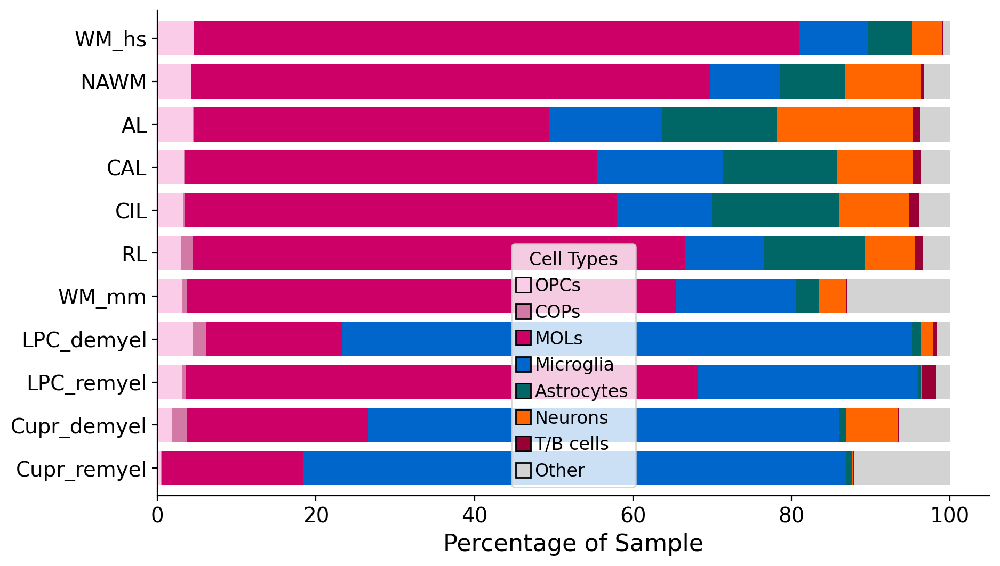

In [23]:
# Define the custom color map for the updated cell types, including 'Other'
custom_colors = {
    'OPCs': '#fbcce7',
    'COPs': '#d279a6',
    'MOLs': '#cc0066',
    'Microglia': '#0066cc',
    'Astrocytes': '#006666',
    'Neurons': '#ff6600',
    'T/B cells': '#990033',
    'Other': '#d3d3d3'  # Light grey for the 'Other' category
}


# Define the colors for the stacked bar chart in the order of desired_cell_types_order_updated
colors = [custom_colors[cell_type] for cell_type in desired_cell_types_order_updated]

# Plot the horizontal stacked bar chart with custom colors
ax = percent_counts_reordered.plot(kind='barh', stacked=True, figsize=(10, 6), color=colors, width=0.8)

# Set the title and labels with increased font size
ax.set_xlabel('Percentage of Sample', fontsize=16)  # Increase font size

# Remove y-axis label
ax.set_ylabel('')  # Empty string to remove label

# Increase font size of ticks
plt.xticks(fontsize=14)  # Increase font size
plt.yticks(fontsize=14)  # Increase font size

# Invert the y-axis to reverse the order
ax.invert_yaxis()

# Remove grid lines
ax.grid(False)

# Remove border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)

# Show only x and y axis lines
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')

# Create legend with dark grey border around color blocks
legend_handles = [plt.Line2D([0], [0], marker='s', color='w', markerfacecolor=custom_colors[col], markersize=10, markeredgecolor='black') for col in percent_counts_reordered.columns]
ax.legend(legend_handles, percent_counts_reordered.columns, loc='lower center', fontsize=12, title='Cell Types')

# Save the plot as a PNG file
plt.savefig('./figures/cell_types_barh2.pdf', bbox_inches='tight', dpi=300)  # Increase DPI for higher resolution

# Show the plot
plt.show()

In [6]:
# Define the mapping dictionary for the remaining values in 'treatment_meta'
treatment_map = {
    'Macnair et al. biorxiv': 'human',
    'Shen et al. 2021': 'mouse',
    'Pandey et al. 2022': 'mouse',
    '(this study)': 'mouse',

}

# Update the 'treatment_meta' column based on the mapping
adata_all.obs['species'] = adata_all.obs['publication'].map(treatment_map)

In [7]:
# Split the dataset into human and mouse
adata_human = adata_all[adata_all.obs['species'] == 'human'].copy()

In [8]:
adata_human

AnnData object with n_obs × n_vars = 321566 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [9]:
sc.pp.filter_genes(adata_human, min_cells=10)

filtered out 8202 genes that are detected in less than 10 cells


In [10]:
adata_human

AnnData object with n_obs × n_vars = 321566 × 29837
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [11]:
# Split the dataset into human and mouse
adata_mouse = adata_all[adata_all.obs['species'] == 'mouse'].copy()

In [12]:
adata_mouse

AnnData object with n_obs × n_vars = 112017 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [13]:
sc.pp.filter_genes(adata_mouse, min_cells=10)

filtered out 16690 genes that are detected in less than 10 cells


In [14]:
adata_mouse

AnnData object with n_obs × n_vars = 112017 × 21349
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_

In [15]:
adata_human.write_h5ad('/scratch365/eaboelno/SAVE_from_afs/human_only_mdata_sysVI.h5ad')

In [16]:
adata_mouse.write_h5ad('/scratch365/eaboelno/SAVE_from_afs/mouse_only_mdata_sysVI.h5ad')

In [17]:
marker_genes = {
    'OL': ['PDGFRA', 'ENPP6', 'SOX10', 'PLP1'],
    'Microglia': ['TREM2', 'C1QA', 'CSF1R'],
    'Astrocytes': ['GFAP', 'AQP4'],
    'Neuroblast': ['SOX2', 'DCX'],
    'Neuron': ['RBFOX1', 'GAP43'],
    'Enothelial': ['PECAM1','FLT1'],
    'Pericytes': ['PDGFRB'],
    'Ependymal': ['FOXJ1'],
    'Chor. plx': ['PRLR'],
    'T cells':['ITK'],
    'B cells': ['IGHG3']
}

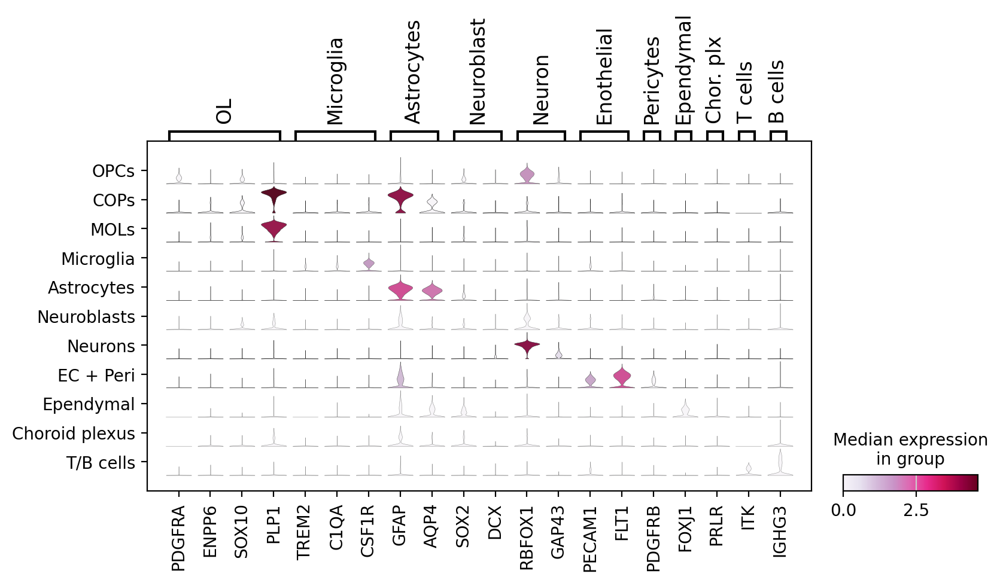

In [19]:
sc.pl.stacked_violin(adata_human, marker_genes, groupby='cluster_annotation', cmap='PuRd')

In [20]:
marker_genes = {
    'OL': ['PDGFRA', 'ENPP6', 'SOX10', 'PLP1'],
    'Microglia': ['TREM2', 'C1QA', 'CSF1R'],
    'Astrocytes': ['GFAP', 'AQP4'],
    'Neuroblast': ['SOX2', 'DCX'],
    'Neuron': ['RBFOX1', 'GAP43'],
    'Enothelial': ['PECAM1','FLT1'],
    'Pericytes': ['PDGFRB'],
    'Ependymal': ['FOXJ1'],
    'Chor. plx': ['PRLR'],
    'T cells':['ITK']
}

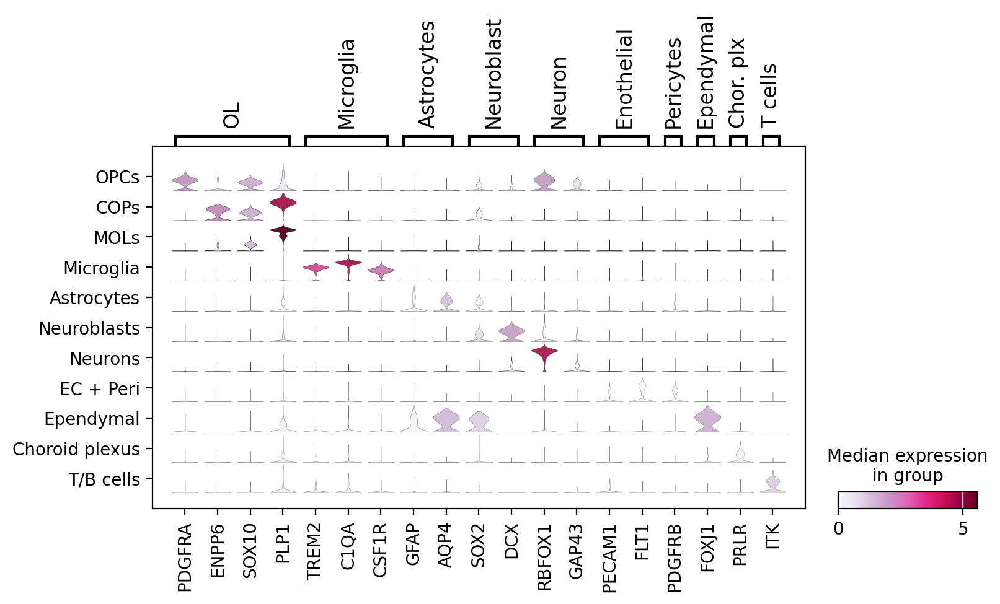

In [21]:
sc.pl.stacked_violin(adata_mouse, marker_genes, groupby='cluster_annotation', cmap='PuRd')

# Split violin plots

In [67]:
genes = [gene for genes_list in marker_genes.values() for gene in genes_list]

In [68]:
df = sc.get.obs_df(adata_all, ['PDGFRA',
                             'ENPP6',
                             'SOX10',
                             'PLP1',
                             'TREM2',
                             'C1QA',
                             'GFAP',
                             'AQP4',
                             'SOX2',
                             'DCX',
                             'RBFOX1',
                             'GAP43',
                             'PECAM1',
                             'FLT1',
                             'PDGFRB',
                             'FOXJ1',
                             'PRLR',
                             'ITK',
                             'IGHG3',
                              'species']
                            )

df = df.set_index('species').stack().reset_index()
df.columns = ['species', 'gene', 'value']

In [69]:
df.head

<bound method NDFrame.head of         species    gene  value
0         mouse  PDGFRA    0.0
1         mouse   ENPP6    0.0
2         mouse   SOX10    0.0
3         mouse    PLP1    0.0
4         mouse   TREM2    0.0
...         ...     ...    ...
8238072   human  PDGFRB    0.0
8238073   human   FOXJ1    0.0
8238074   human    PRLR    0.0
8238075   human     ITK    0.0
8238076   human   IGHG3    0.0

[8238077 rows x 3 columns]>

In [70]:
# Assuming `df` is your DataFrame
df = df[df['value'] != 0]

# If you want to reset the index after removing rows
df.reset_index(drop=True, inplace=True)
df.head

<bound method NDFrame.head of        species    gene     value
0        mouse     DCX  1.103929
1        mouse  RBFOX1  4.496512
2        mouse   GAP43  0.514019
3        mouse    AQP4  0.519066
4        mouse  RBFOX1  5.037620
...        ...     ...       ...
966323   human    C1QA  2.579847
966324   human    PLP1  3.093935
966325   human    PLP1  3.896176
966326   human    SOX2  1.160504
966327   human  RBFOX1  2.481376

[966328 rows x 3 columns]>

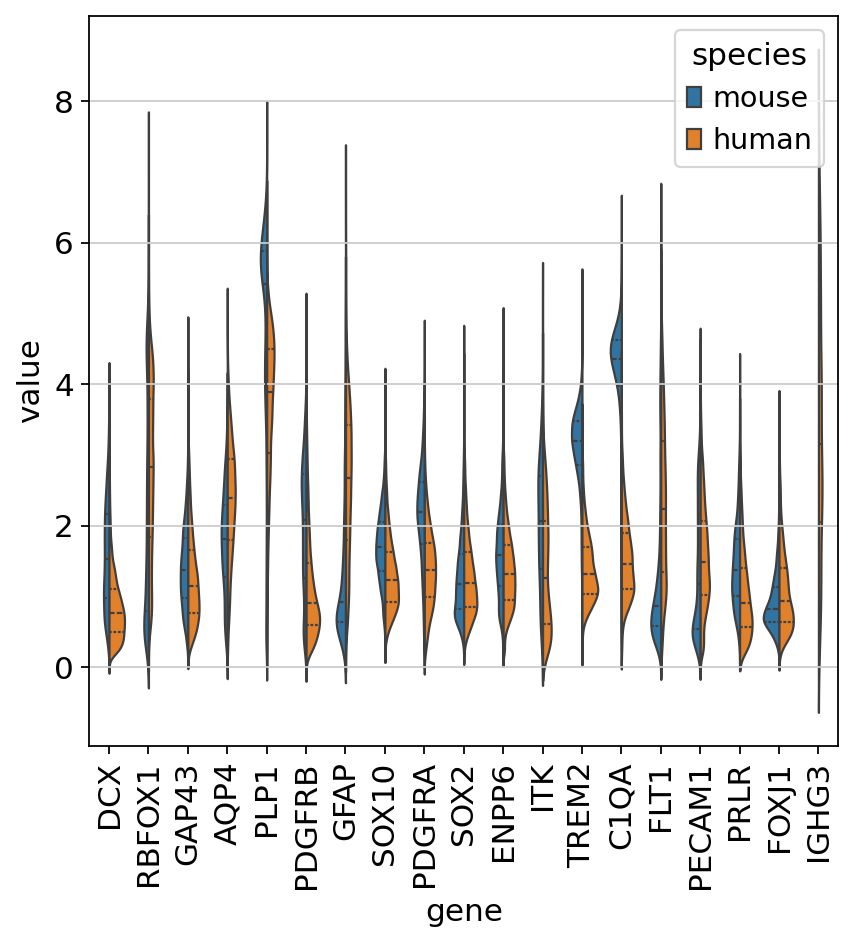

In [71]:
# Create the violin plot
sns.violinplot(data=df, x='gene', y='value', hue="species",
                split=True, inner="quart", linewidth=1)

# Rotate the x-axis labels
plt.xticks(rotation=90)

# Show the plot
plt.show()

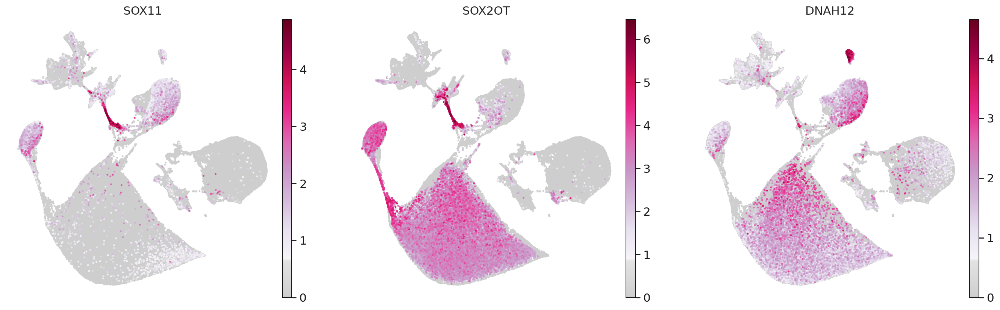

In [54]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import numpy as np
import scanpy as sc


# Set figure parameters for high-resolution display and saving
sc.set_figure_params(dpi_save=300, figsize=(6, 6), transparent=True)

# Define a nice color map for gene expression
colors2 = plt.cm.PuRd(np.linspace(0, 1, 128))  # Use PuRd color map for deep red/purple color
colors3 = plt.cm.Greys_r(np.linspace(0.7, 0.8, 20))  # Greys for low values
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

sc.pl.umap(adata_all, 
           color=[ 'SOX11', 'SOX2OT', 'DNAH12'
                 ],
           color_map=mymap, 
           ncols=4, 
           frameon=False, 
           s=20, 
           legend_fontweight='bold', 
           legend_fontoutline=1)
           #save='_Human_scVI_ALL_markers.pdf')

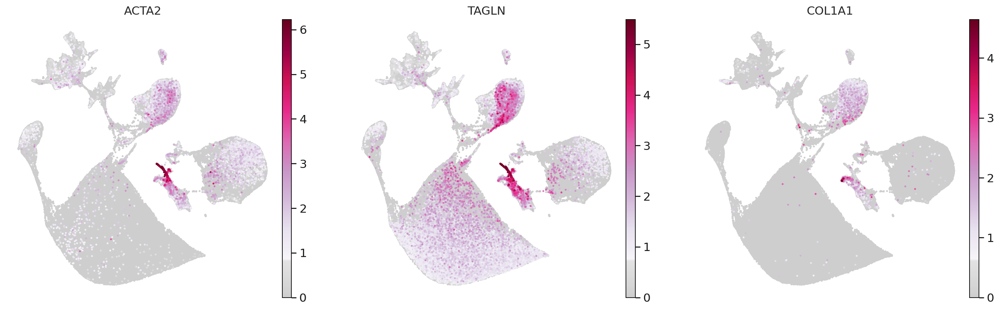

In [55]:
sc.pl.umap(adata_all, 
           color=[ 'ACTA2', 'TAGLN', 'COL1A1'
                 ],
           color_map=mymap, 
           ncols=4, 
           frameon=False, 
           s=20, 
           legend_fontweight='bold', 
           legend_fontoutline=1)
           #save='_Human_scVI_ALL_markers.pdf')

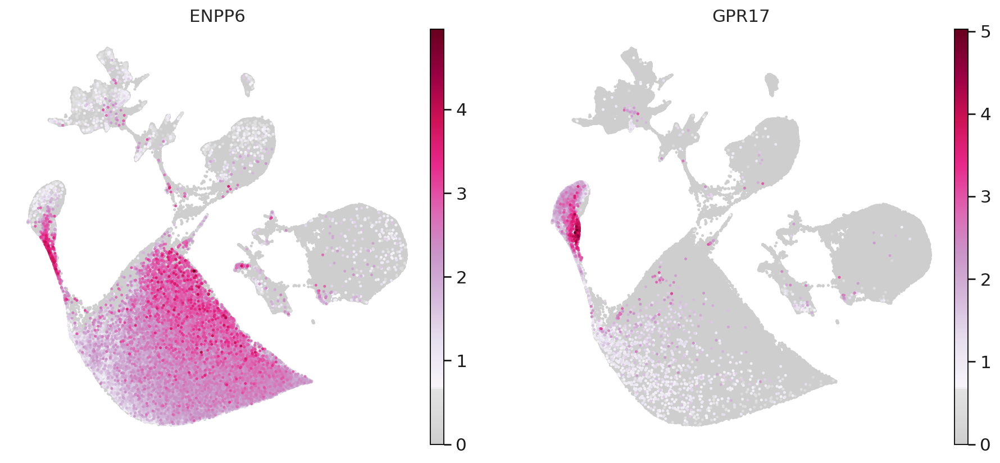

In [65]:
sc.pl.umap(adata_all, 
           color=[ 'ENPP6', 'GPR17'
                 ],
           color_map=mymap, 
           ncols=4, 
           frameon=False, 
           s=20, 
           legend_fontweight='bold', 
           legend_fontoutline=1)
           #save='_Human_scVI_ALL_markers.pdf')

In [143]:
adata_all.write('./sysVI_h2m_NEW_allgenes.h5ad')
adata_all

AnnData object with n_obs × n_vars = 433583 × 38039
    obs: 'sample_id', 'publication', 'sample_id_anon', 'individual_id_anon', 'replicate', 'treatment', 'condition', 'tissue', 'time', 'batch', 'lesion_type', 'sample_source', 'diagnosis', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 's_score', 'g2m_score', 'phase', 'type_fine', 'type_broad', 'cluster_zoom', 'exclude_pseudobulk', 'seq_pool', 'sex', 'age_at_death', 'smoker', 'cause_of_death', 'years_w_ms', 'pmi_minutes', 'age_scale', 'age_cat', 'pmi_cat', 'pmi_cat2', 'cell_cycle_diff', 'cell_type_eval', 'library_type', 'sample_type', 'organism', 'system', 'n_counts', 'treatment_min', 'system_map', 'sys_leiden_1', 'sys_leiden_1.5', 'sys_leiden_2', 'cell_type_abbrev', 'treatment_meta', 'indiv_treatment_time', 'pub_treatment_lesion', 'lesion_status', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'total_counts_ribo', 'log1p_total_counts_